# What to do with thousands of neurons in visual cortex?  

# 0. Loading and preparing. 

### Load in the Python libraries

In [2]:
import os # os stands for "operating system" and includes read/write routines etc. 
import numpy as np # by far the most used library for everyday computation
from scipy import stats # here we import a whole sub-library of stats functions
from scipy.ndimage import gaussian_filter, gaussian_filter1d # here we import a single function
from sklearn.decomposition import PCA # check out all the other dimensionality reduction methods in "decomposition"
from matplotlib import pyplot as plt # all of our plotting is done with plt
%matplotlib inline 
# %matplotlib notebook # if you need to zoom into a figure, this is the "interactive" mode of IPython

# this function performs a running average filter over the first dimension of X
# (faster than doing gaussian filtering)
def running_average(X, nbin = 100):
    Y = np.cumsum(X, axis=0)
    Y = Y[nbin:, :] - Y[:-nbin, :]
    return Y

# * set root to the location where you downloaded the data *
root      = 'C:/Users/hamed/Desktop/Hamed/test/data/9505250'

# LOAD the visual stimuli "mov" and the timings "iframe"
mov    = np.load(os.path.join(root, 'mov.npy')) # these are the visual stimuli shown
iframe = np.load(os.path.join(root, 'iframe.npy')) # iframe[n] is the microscope frame for the image frame n

# LOAD the neural data
spks = np.load(os.path.join(root, 'spks.npy')) # deconvolved data
stat = np.load(os.path.join(root, 'stat.npy'), allow_pickle=True) # these are the per-neuron stats returned by suite2p
# these are the neurons' 2D coordinates
ypos = np.array([stat[n]['med'][0] for n in range(len(stat))]) 
# (notice the python list comprehension [X(n) for n in range(N)])
xpos = np.array([stat[n]['med'][1] for n in range(len(stat))]) 

del stat # we delete stat because we don't need any other fields from it


FileNotFoundError: [Errno 2] No such file or directory: 'C:/Users/hamed/Desktop/Hamed/test/data/9505250\\mov.npy'

### Align stimuli and neural data

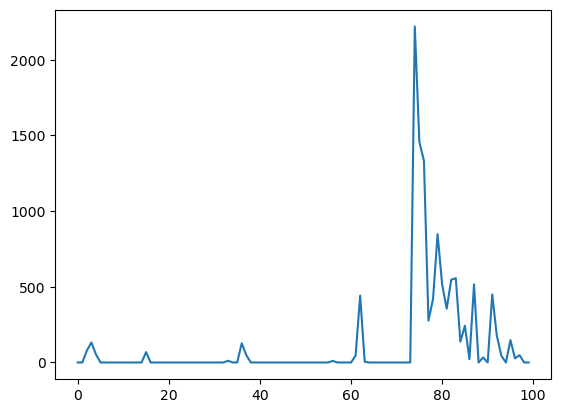

In [23]:
# align stimuli to spks (since stimuli are triggered by microscope it's easy)
dt = 1 # time offset between stimulus presentation and response
ivalid = iframe+dt<spks.shape[-1] # remove timepoints outside the valid time range
iframe = iframe[ivalid]
mov = mov[:, :, ivalid]
S = spks[:, iframe+dt]
del spks
S = stats.zscore(S, axis=1) # z-score the neural activity before doing anything

# 1. Single neuron receptive fields

Let's first look at the positions of the neurons.

Text(0, 0.5, 'Y position (um)')

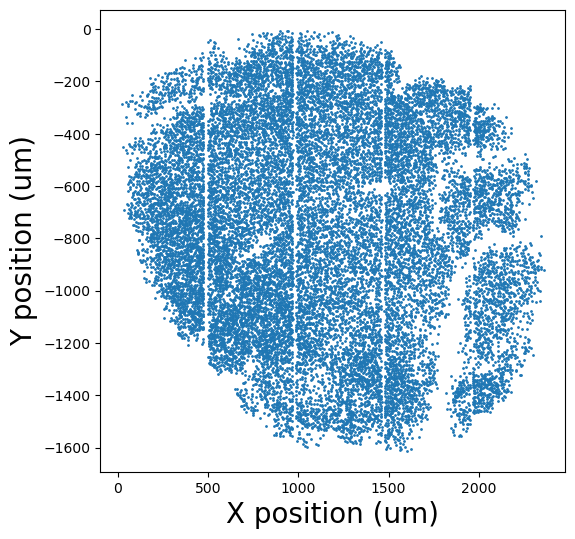

In [24]:
# POSITIONS OF ALL NEURONS
plt.figure(figsize=(6,6))
plt.scatter(xpos, -ypos, s = 1)
plt.xlabel('X position (um)', fontsize=20)
plt.ylabel('Y position (um)', fontsize=20)

And what does the stimulus look like on each frame?

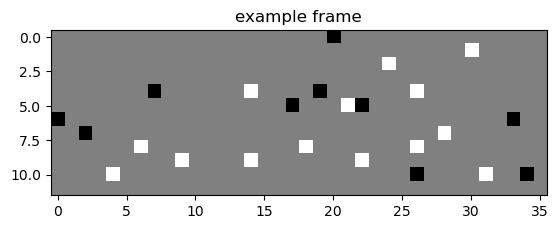

In [25]:
# STIMULUS FRAME
plt.figure()
plt.imshow(mov[:,:,100], cmap='gray')
plt.title('example frame')
plt.show()

Text(0.5, 0, 'time points')

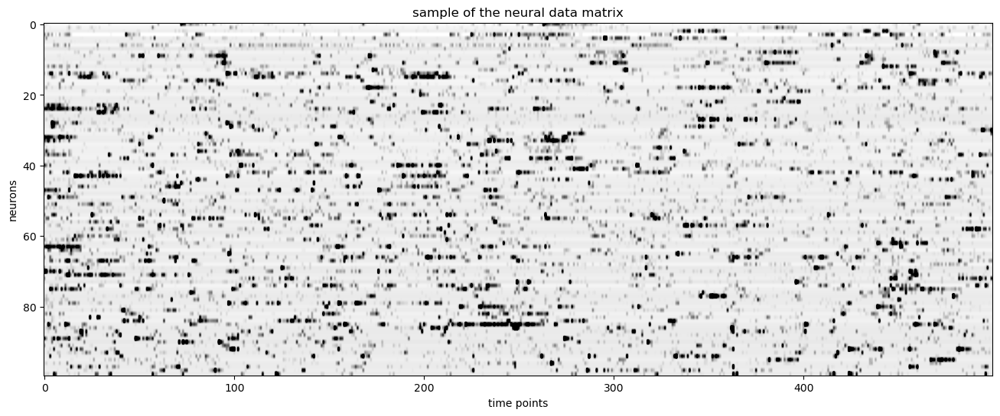

In [26]:
plt.figure(figsize=(16,6))
plt.imshow(S[:100, :500], vmax = 3, vmin = -0.5, aspect='auto', cmap = 'gray_r')
plt.title('sample of the neural data matrix')
plt.ylabel('neurons') 
plt.xlabel('time points')

### First, compute ordinary ON - OFF receptive fields for each neuron

In [27]:
NN, NT = S.shape 

X = np.reshape(mov, [-1, NT]) # reshape to Npixels by Ntimepoints
X = X-0.5 # center at 0
#X = np.abs(X-0.5) # center at 0
X = stats.zscore(X, axis=1)/NT**.5  # z-score each pixel separately
npix = X.shape[0]

lam = 0.01 # regularizer for ridge regression
B0 = np.linalg.solve((X @ X.T + lam * np.eye(npix)),  (X @ S.T)) # get the receptive fields for each neuron
        
B0 = np.reshape(B0, [mov.shape[0], mov.shape[1], NN])
B0 = gaussian_filter(B0, [.5, .5, 0]) # smooth each receptive field a little

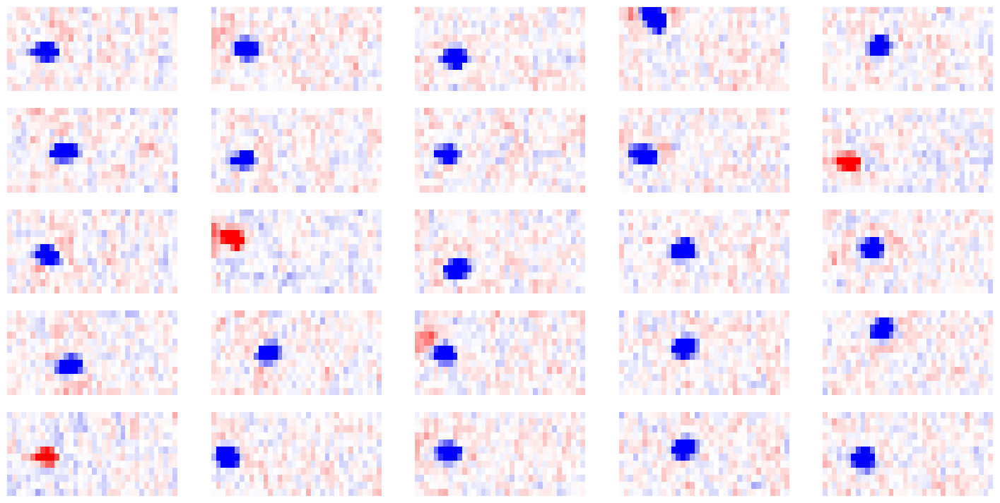

In [28]:
Spred = np.reshape(B0, (-1,NN)).T @ X
Spred -= S
varexp = 1.0 - (Spred**2).mean(axis=-1)
asort = np.argsort(varexp)[::-1]

plt.figure(figsize=(18, 9))
for j in range(5*5):
    plt.subplot(5,5,j+1)
    plt.imshow(B0[:,:,asort[j]], aspect='auto', vmin=-6, vmax=6, cmap = 'bwr') # plot the receptive field for each neuron
    plt.axis('off')  
plt.show()

### Now let's compute ON + OFF receptive fields

In [29]:
X = np.abs(X) # response is the same for ON and OFF squares (WHITE OR BLACK)

X = stats.zscore(X, axis=1)/NT**.5  # z-score each pixel separately
lam = 0.01 # regularizer for ridge regression
B0 = np.linalg.solve((X @ X.T + lam * np.eye(npix)),  (X @ S.T)) # get the receptive fields for each neuron
        
B0 = np.reshape(B0, [mov.shape[0], mov.shape[1], NN])
B0 = gaussian_filter(B0, [.5, .5, 0]) # smooth each receptive field a little

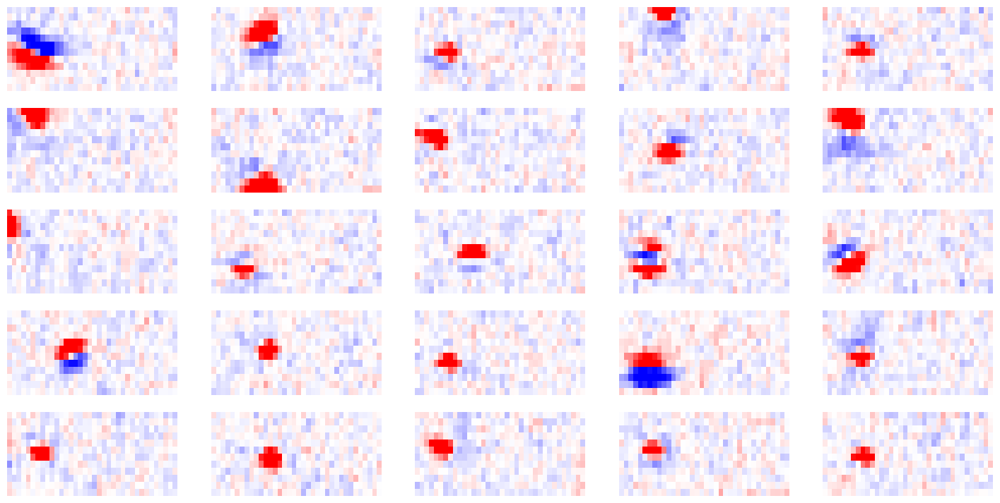

In [30]:
Spred = np.reshape(B0, (-1,NN)).T @ X
Spred -= S
varexp = 1.0 - (Spred**2).mean(axis=-1)
asort = np.argsort(varexp)[::-1]

plt.figure(figsize=(18, 9))
for j in range(5*5):
    plt.subplot(5,5,j+1)
    plt.imshow(B0[:,:,asort[j]], aspect='auto', vmin=-6, vmax=6, cmap = 'bwr') # plot the receptive field for each neuron
    plt.axis('off')   
plt.show()

## Average over RFs in local region

Create distance matrix and then average neurons within 50 um of each neuron.

In [31]:
deltay = ypos[:, np.newaxis] - ypos # np.newaxis creates a new axis
deltax = xpos[:, np.newaxis] - xpos # a vector of N by 1 can broadcast with a vector of 1 by N to give a matrix N by N
ds = (deltay**2 + deltax**2)**.5 # **2 means elementwise squaring
del deltay, deltax

# find all neurons within 50 um and average over their RFs
sig = 50 # spatial scale for smoothing
B = np.zeros(B0.shape)
for j in range(NN):
    ix = ds[:,j]<sig
    B[:,:,j] = np.mean(B0[:,:,ix], axis=-1) # average receptive fields within sig
    

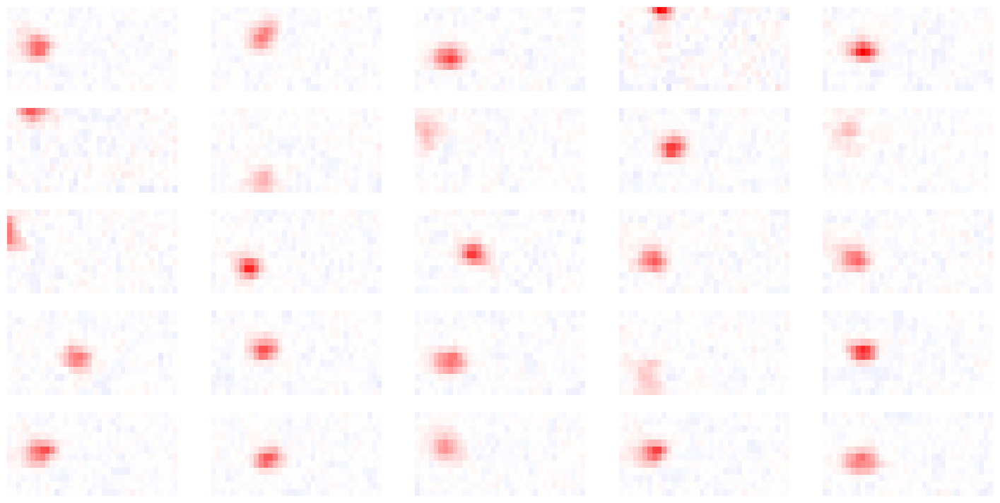

In [32]:
Spred = np.reshape(B0, (-1,NN)).T @ X
Spred -= S
varexp = 1.0 - (Spred**2).mean(axis=-1)
asort = np.argsort(varexp)[::-1]

plt.figure(figsize=(18, 9))
for j in range(5*5):
    plt.subplot(5,5,j+1)
    plt.imshow(B[:,:,asort[j]], aspect='auto', vmin=-6, vmax=6, cmap = 'bwr') # plot the receptive field for each neuron
    plt.axis('off')
    
plt.show()

Create retinotopy. Take the max of each averaged receptive field and use as receptive field location.

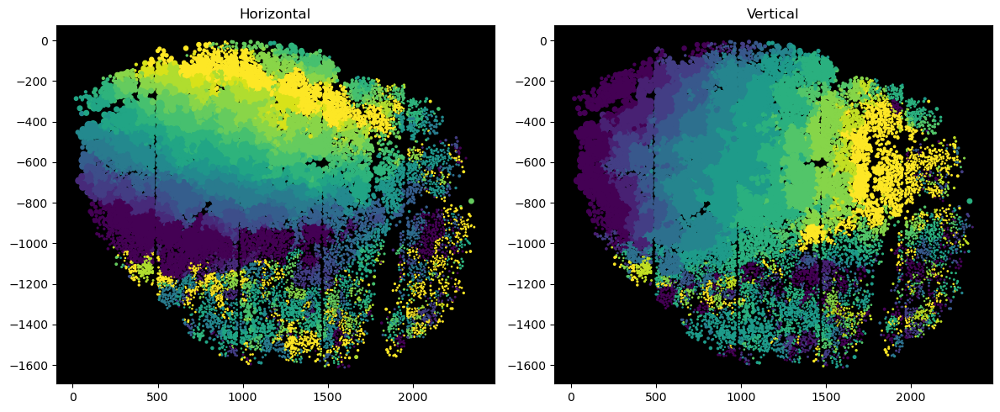

In [33]:
imax = np.argmax(np.reshape(B, [-1,NN]), axis=0) # find the pixel corresponding to the max response for each cell
ly, lx, nstim = mov.shape

# xmax, ymax = np.unravel(imax, (ly, lx)) # unravel an index for a (1,ly*lx) array, to two indices for an (ly, lx) array
xmax = np.minimum(17, imax%lx)
ymax = (imax/lx).astype('int')

plt.figure(figsize=(12,5))
Amax = np.max(B, axis=(0,1)) - np.min(B, axis=(0,1))
plt.subplot(1,2,1, facecolor=[0, 0, 0])
plt.scatter(xpos, -ypos, s = (Amax)**2, c = xmax, cmap='viridis')
plt.title('Horizontal')

plt.subplot(1,2,2, facecolor=[0, 0, 0])
plt.scatter(xpos, -ypos, s = (Amax)**2, c = ymax, cmap='viridis')
plt.title('Vertical')

plt.tight_layout()

plt.show()

# 2. Dimensionality reduction: what are the dominant patterns of activity?

Let's look at the top PCs

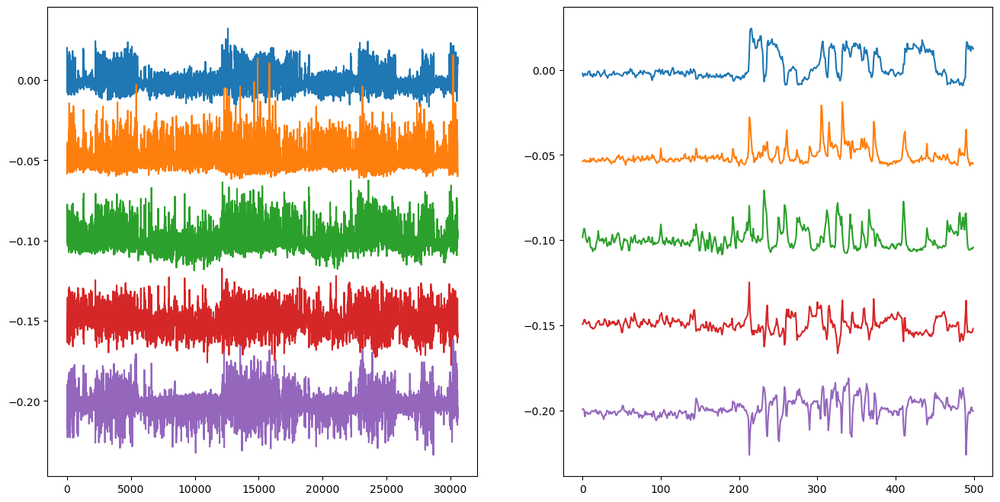

In [34]:
# show that components do not necessarily have receptive fields
from sklearn.decomposition import PCA
model = PCA(n_components = 100)
model.fit(S)

# plot some components
X = model.components_

plt.figure(figsize=(16,8))
plt.subplot(1,2,1)
for j in range(5):
    plt.plot(X[j] - j * .05)
plt.subplot(1,2,2)
for j in range(5):
    plt.plot(X[j, 2000:2500] - j * .05)
plt.show()

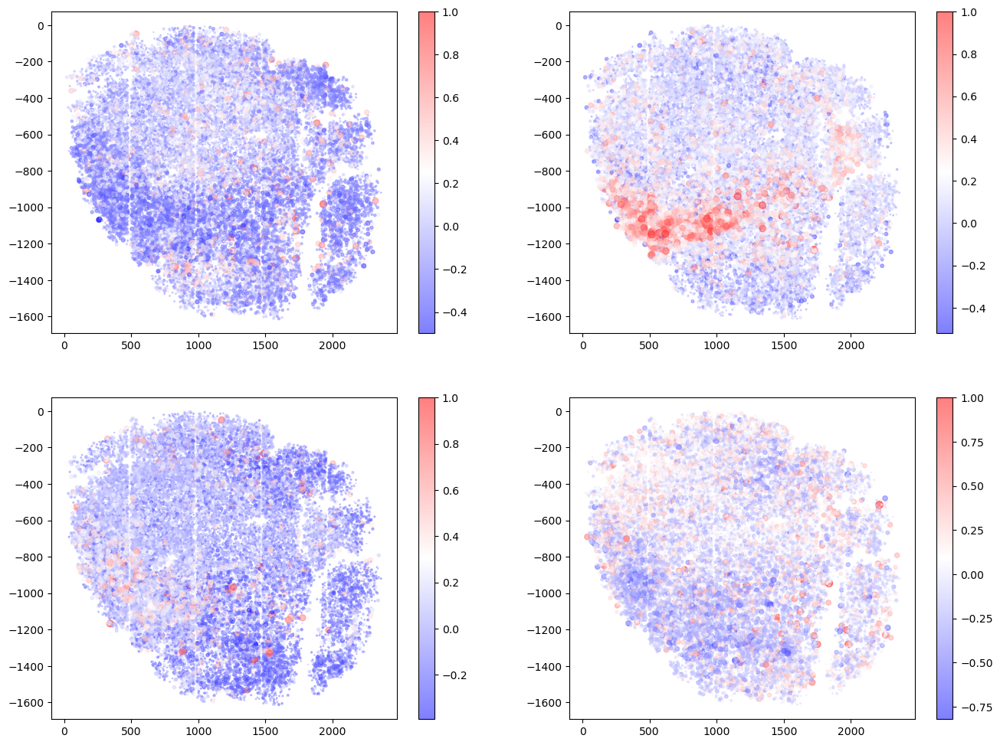

In [35]:
# HERE color cells according to their PC weights
plt.figure(figsize=(16,12))
for j in range(4):
    pc0 = S @ model.components_[j]
    pc0 = pc0/np.max(np.abs(pc0))
    lam = np.abs(pc0)    
    plt.subplot(2,2,1+j)
    plt.scatter(xpos, -ypos, s = 50 * lam, c = pc0, cmap='bwr', alpha = .5)
    plt.colorbar()

Receptive fields of the PCs:

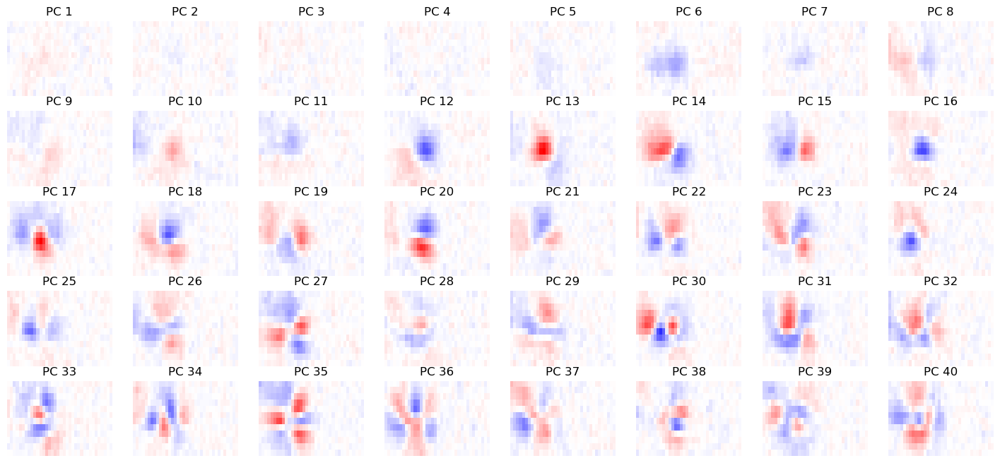

In [36]:
from scipy.stats import zscore
Sp = model.components_
Sp = zscore(Sp, axis=1)
ly, lx, nstim = mov.shape

NN, NT = S.shape 

X = np.reshape(mov, [-1, NT]) # reshape to Npixels by Ntimepoints
X = X-0.5 # subtract the background
X = np.abs(X) # does not matter if a pixel is black (0) or white (1)
X = stats.zscore(X, axis=1)/NT**.5  # z-score each pixel separately
npix = X.shape[0]

lam = .0001
ncomps = Sp.shape[0]
B0 = np.linalg.solve((X @ X.T + lam * np.eye(npix)),  (X @ Sp.T)) # get the receptive fields for each neuron

B0 = np.reshape(B0, (ly, lx, ncomps))
B0 = gaussian_filter(B0, [.5, .5, 0]) # smooth each receptive field a little

plt.figure(figsize=(18, 8))
rfmax = np.max(B0)
for j in range(40):
    plt.subplot(5,8,j+1)
    rf = B0[:,:,j]
    # rfmax = np.max(np.abs(rf))
    plt.imshow(rf, aspect='auto', cmap = 'bwr', vmin = -rfmax, vmax = rfmax) # plot the receptive field for each neuron
    plt.title('PC %d'%(1+j))
    plt.axis('off')
    
plt.show()    

## Two mysteries

1. Why don't the top PCs have receptive fields?
2. Why do the PC receptive fields look like that?
    - PCs of translation-invariant data always look like that


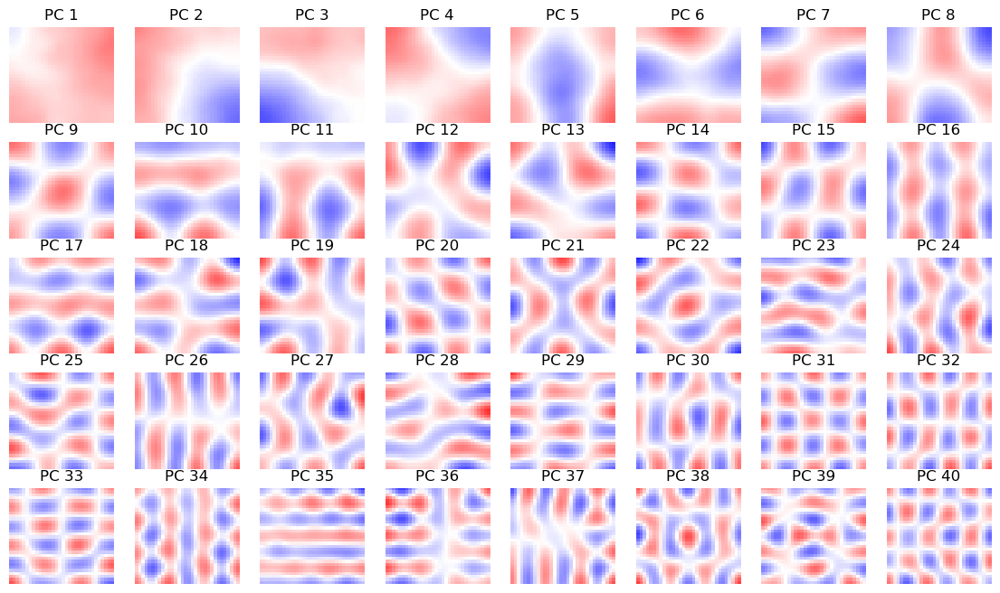

In [37]:
# solve the second mystery: PCA of translation-invariant data always looks like that
# make some random noise and smooth it
nPC = 50

Xn = np.random.randn(10000, 32,32)
Xn = gaussian_filter(Xn, [0, 2, 2])
Xn = np.reshape(Xn, (10000, -1))
model = PCA(n_components= nPC).fit(Xn)

bPC = np.reshape(model.components_.T, (32,32, nPC))
plt.figure(figsize=(14, 8))
rfmax = np.max(bPC)
for j in range(40):
    plt.subplot(5,8,j+1)
    rf = bPC[:,:,j]
    # rfmax = np.max(np.abs(rf))
    plt.imshow(rf, aspect='auto', cmap = 'bwr', vmin = -rfmax, vmax = rfmax) # plot the receptive field for each neuron
    plt.title('PC %d'%(1+j))    
    plt.axis('off')
plt.show()    

# compare with DCT https://en.wikipedia.org/wiki/Discrete_cosine_transform
del Xn    

# 3. Rastermap

Rastermap re-arranges neurons in the raster plot based on similarity of activity

We can first run rastermap in suite2p and then in the notebook.

In [21]:


from rastermap import Rastermap

# we run rastermap the same way that the other scikit-learn embedding algorithms work
model = Rastermap(n_components=1, n_X=100).fit(S) 

ModuleNotFoundError: No module named 'rastermap'

In [39]:
np.shape(S)



(18795, 30560)

NameError: name 'd' is not defined

In [41]:
# the manifold embedding is in model.embedding
isort = np.argsort(model.embedding[:,0])

# sort by embedding and smooth over neurons
Sfilt = running_average(S[isort, 2000:2500], 50)
Sfilt = stats.zscore(Sfilt, axis=1)


In [42]:
print(np.shape(model.embedding))

(18795, 1)


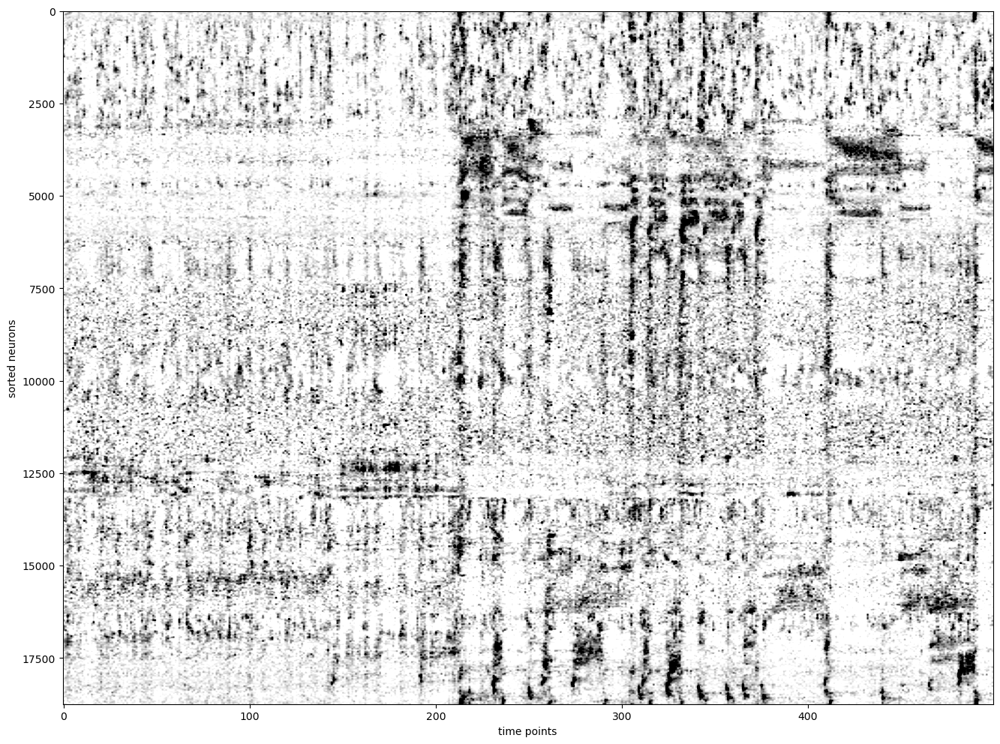

In [43]:
plt.figure(figsize=(16,12))
plt.imshow(Sfilt, vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r')
plt.xlabel('time points')
plt.ylabel('sorted neurons')
plt.show()

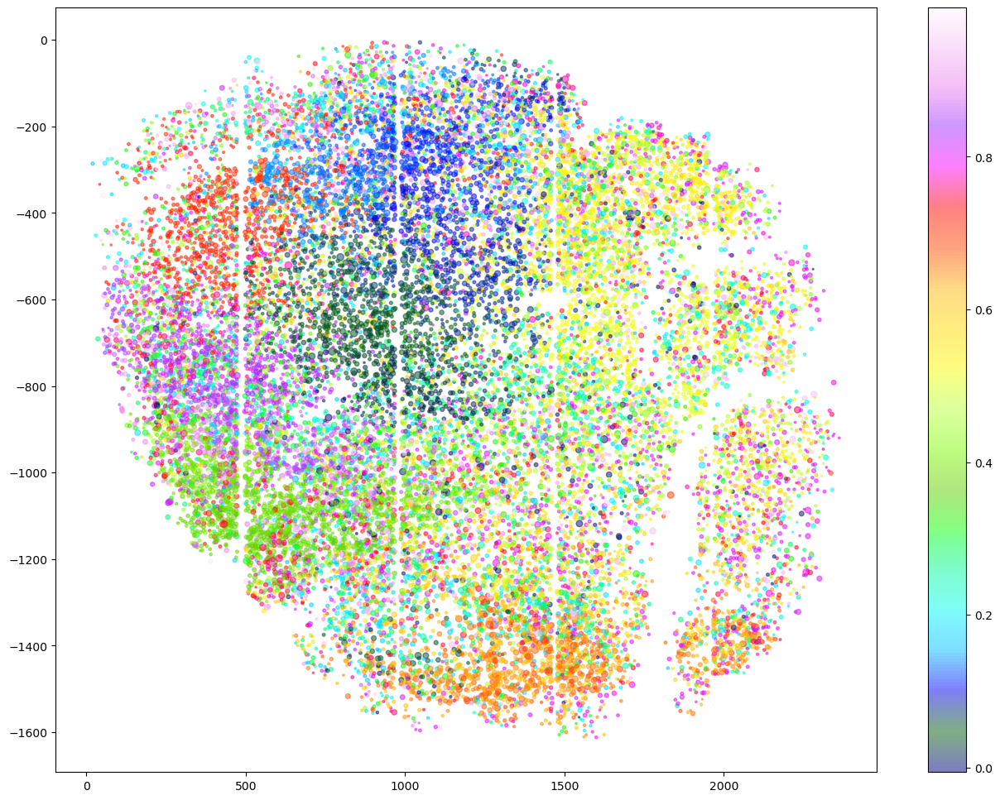

In [44]:
# HERE color cells according to their rastermap embedding
lam=model.lam
plt.figure(figsize=(16,12))
plt.scatter(xpos, -ypos, s=50*lam/np.max(lam), c=model.embedding[:,0], 
            cmap='gist_ncar', alpha = .5)
plt.colorbar()
plt.show()

Do the rastermap components have receptive fields?

In [45]:
NN, NT = S.shape 

# reshape and sum S across neurons to get "components"
nc = 100
NC = int(np.floor(NN / nc))
Sp = np.reshape(S[isort][:nc*NC], (NC, nc, NT))
Sp = Sp.mean(axis=1)

ly, lx, nstim = mov.shape

X = np.reshape(mov, [-1, NT]) # reshape to Npixels by Ntimepoints
X = np.abs(X-0.5) # does not matter if a pixel is black (0) or white (1)
X = stats.zscore(X, axis=1)/NT**.5  # z-score each pixel separately
npix = X.shape[0]

lam = .01
ncomps = Sp.shape[0]
B0 = np.linalg.solve((X @ X.T + lam * np.eye(npix)),  (X @ Sp.T)) # get the receptive fields for each neuron

B0 = np.reshape(B0, (ly, lx, ncomps))
B0 = gaussian_filter(B0, [.5, .5, 0]) # smooth each receptive field a little

(432, 30560)

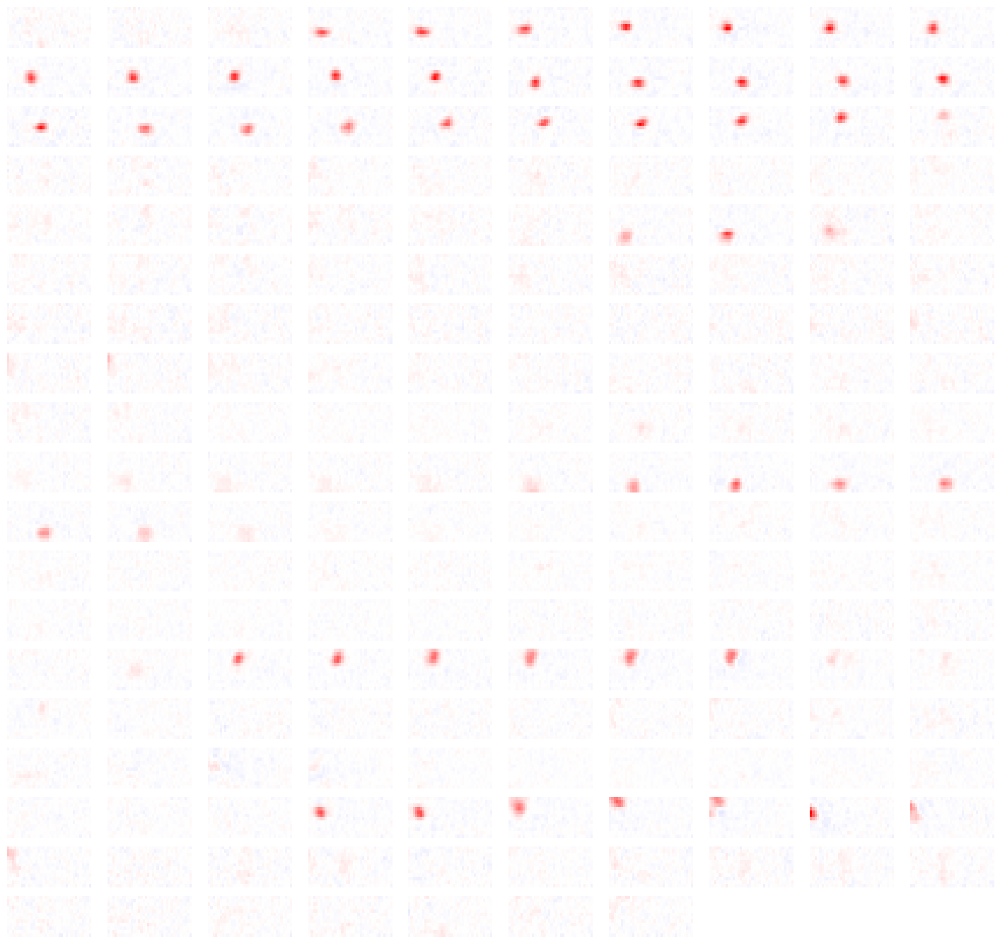

In [46]:
# plot receptive fields
plt.figure(figsize=(18, 18))
rfmax = np.max(B0)
for j in range(0, B0.shape[-1]):
    plt.subplot(20,10,j+1)
    rf = B0[:,:,j]
    # rfmax = np.max(np.abs(rf))
    plt.imshow(rf, aspect='auto', cmap = 'bwr', vmin = -rfmax, vmax = rfmax) # plot the receptive field for each neuron    
    plt.axis('off')
    
plt.show()    

# 4. Behavioral analysis

What are these other groups of neurons responding to?

In [47]:
# LOAD IN BEHAVIORAL DATA
proc = np.load(os.path.join(root, 'cam1_TX39_2019_05_31_1_proc_resampled.npy'), allow_pickle=True).item()
motSVD = proc['motSVD'][:,iframe+dt]
parea = proc['pupil']['area'][0][iframe+dt].copy()

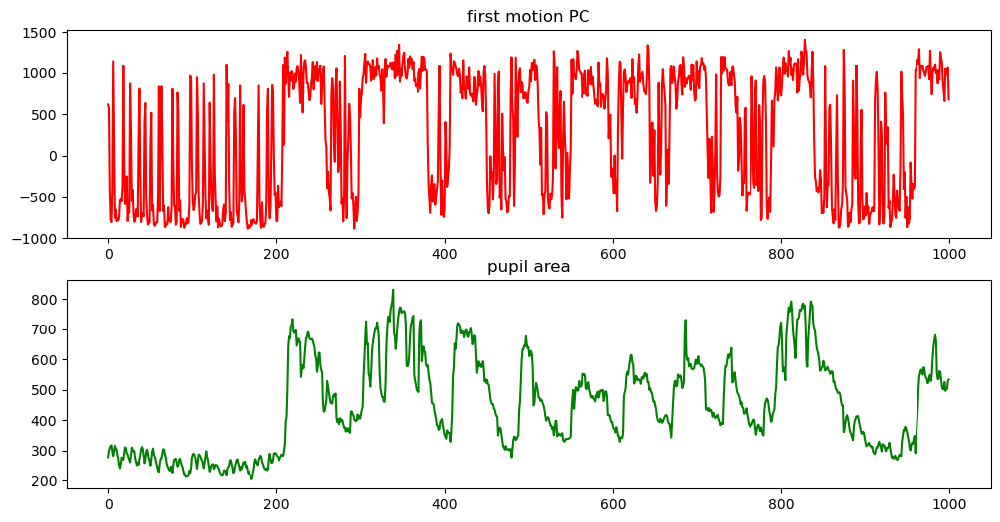

In [48]:
plt.figure(figsize=(12,6))
plt.subplot(2,1,1)
plt.plot(motSVD[0,2000:3000]*-1, color='r')
plt.title('first motion PC')

plt.subplot(2,1,2)
plt.plot(parea[2000:3000], color='g')
plt.title('pupil area')
plt.show()

### Bin neural and behavioral data
We will bin the neural activity and the behavior (1 second bins)

In [49]:
# bin data
tbin = 3.0
NT = motSVD.shape[1]
nt = int(np.floor(NT/tbin))
motSVD -= motSVD.mean(axis=1)[:,np.newaxis]
parea  -= np.nanmean(parea)
parea[np.isnan(parea)] = 0
tbin = int(tbin)

beh = np.reshape(motSVD[:,:nt*tbin], (motSVD.shape[0], nt, tbin)).mean(axis=-1)
pup = np.reshape(parea[:nt*tbin], (nt, tbin)).mean(axis=-1)

# using this format bin S
Sbin = np.reshape(S[:,:nt*tbin], (S.shape[0], nt, tbin)).mean(axis=-1)
Spbin = np.reshape(Sp[:,:nt*tbin], (Sp.shape[0], nt, tbin)).mean(axis=-1)

# use PCs of neural activity
model = PCA(n_components=64).fit(Sbin)
V = model.components_ # time components
sv = model.singular_values_
U = np.matmul(Sbin,V.T) / sv # neuron components
V *= sv[:,np.newaxis]

np.shape(V.T)

We have to do a train-test split to do prediction

C:\Users\hamed\AppData\Local\Temp\ipykernel_19404\2253817000.py:7: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  itrain = np.ones(nt, np.bool)


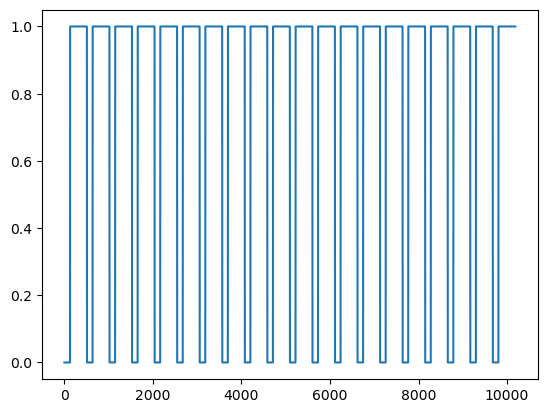

In [50]:
# split into train-test
# * use interleaved segments *
nsegs = 20
nlen  = nt/nsegs
ninds = np.linspace(0,nt-nlen,nsegs).astype(int)
itest = (ninds[:,np.newaxis] + np.arange(0,nlen*0.25,1,int)).flatten()
itrain = np.ones(nt, np.bool)
itrain[itest] = 0

plt.plot(itrain)
plt.show()

Can you determine how I did the split above? Why might I have split into segments rather than randomly interleaving time-points?

# Prediction with behavioral variables

Use linear regression to perform the prediction, predict $Y$ using $X$:

$$ A = (X_\text{train}X_\text{train}^\top)^{-1} (X_\text{train} Y_\text{train}^\top)$$

$X$ is behavioral components by time, $Y$ is neural components by time. If you want to regularize the linear regression:

$$ A = (X_\text{train}X_\text{train}^\top + \lambda I)^{-1} (X_\text{train} Y_\text{train}^\top)$$

Then the prediction on time points is:

$$ \hat Y_\text{test} = A^\top X_\text{test} $$

In [57]:
A = np.matmul(pup[itrain], V[:,itrain].T)/(pup**2).sum()
np.shape(V[:,itrain].T)

(7626, 64)

In [ ]:
covM = np.matmul(beh[:,itrain], beh[:,itrain].T)

(beh.shape)

(500, 10186)

In [ ]:
#### PREDICT USING PUPIL WITH LINEAR REGRESSION

A = np.matmul(pup[itrain], V[:,itrain].T)/(pup**2).sum()

Vpredp = np.matmul(A[:,np.newaxis], pup[itest][np.newaxis,:])

varexp_pupil = 1 - ((Vpredp - V[:,itest])**2).sum(axis=1)/(V[:,itest]**2).sum(axis=1)

#### PREDICT USING BEHAVIOR PC'S 
## regularized linear regression from behavior to neural PCs
covM = np.matmul(beh[:,itrain], beh[:,itrain].T)
lam = 1e5 # regularizer
covM += lam*np.eye(beh.shape[0])
A = np.linalg.solve(covM, np.matmul(beh[:,itrain], V[:,itrain].T))

Vpred = np.matmul(A.T, beh[:,itest])

varexp = 1 - ((Vpred - V[:,itest])**2).sum(axis=1)/(V[:,itest]**2).sum(axis=1)

NameError: name 'pup' is not defined

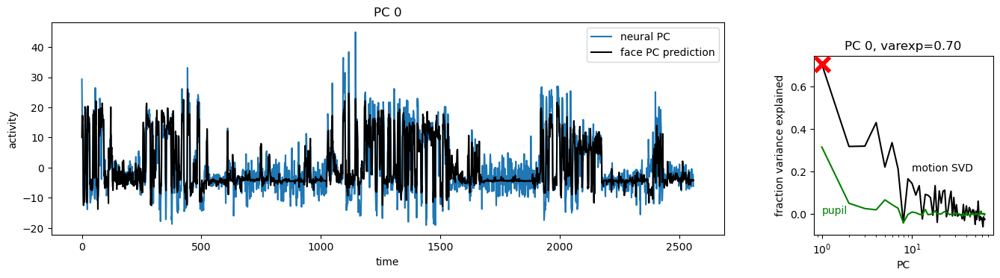

In [ ]:
# plot of principal component activity and variance explained

fig=plt.figure(figsize=(12,3))

ipc = 0 ### which PC to plot

ax = fig.add_axes([0.05,.05,.75,.95])
ax.plot(V[ipc,itest], label='neural PC')
ax.plot(Vpred[ipc], color='k', label='face PC prediction')
ax.set_title('PC %d'%ipc)
ax.set_xlabel('time')
ax.set_ylabel('activity')
ax.legend()

ax = fig.add_axes([0.9,.05, .2, .8])
ax.semilogx(np.arange(1,varexp.size+1), varexp, color='k')
ax.scatter(ipc+1, varexp[ipc],marker='x',color='r',s=200, lw=4, zorder=10)
ax.semilogx(np.arange(1,varexp.size+1), varexp_pupil, color=[0.,.5,0])
ax.text(1,0,'pupil',color=[0,.5,0])
ax.text(10,0.2,'motion SVD')
ax.set_xlabel('PC')
ax.set_ylabel('fraction variance explained')
ax.set_title('PC %d, varexp=%0.2f'%(ipc,varexp[ipc]))
plt.show()

In [ ]:
# sort data by rastermap + smooth
Sfilt = running_average(Sbin[isort][:,itest])
Sfilt = stats.zscore(Sfilt, axis=1)

Spred = np.matmul(U, Vpred)
Sfilt_pred = running_average(Spred[isort, :])
Sfilt_pred = stats.zscore(Sfilt_pred, axis=1)

In [ ]:
np.shape(Vpred)

(64, 2560)

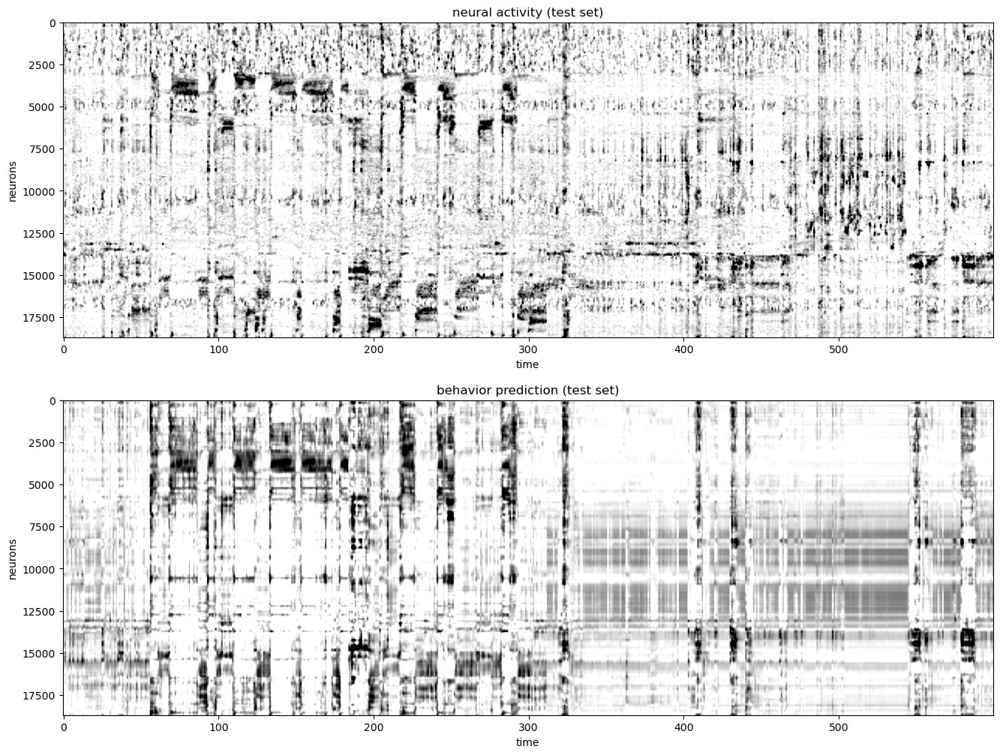

In [ ]:
### plot data + prediction
fig = plt.figure(figsize=(16,12))
ax = fig.add_subplot(2,1,1)
ax.imshow(Sfilt[:,200:800], vmin = -.5, vmax=3, aspect='auto', cmap = 'gray_r')
ax.set_xlabel('time')
ax.set_ylabel('neurons')
ax.set_title('neural activity (test set)')

ax = fig.add_subplot(2,1,2)
ax.imshow(Sfilt_pred[:,200:800], vmin = -.5, vmax=3, aspect='auto', cmap = 'gray_r')
ax.set_xlabel('time')
ax.set_ylabel('neurons')
ax.set_title('behavior prediction (test set)')

plt.show()

how good is the behavioral prediction across the rastermap?

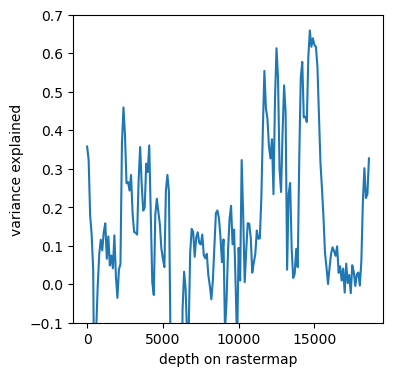

In [ ]:
# bin across the rastermap in groups of 100 neurons
Spbin_pred = np.reshape(Spred[isort][:nc*NC,:], (NC, nc, -1)).mean(axis=1)
Spbin_pred -= Spbin[:,itest]

varexp_RM = 1 - Spbin_pred.var(axis=1) / Spbin.var(axis=1)

#Spbin_pred = zscore(Spbin_pred, axis=1)
#Spbin = zscore(Spbin, axis=1)
#cc = np.matmul(Spbin, Spbin_pred.T) / Spbin.shape[-1]
#cpred = np.diag(cc)

# prediction quality across the rastermap
fig = plt.figure(figsize=(4,4))
ax = fig.add_subplot(1,1,1)
ax.plot(np.arange(0,Spbin.shape[0])*nc, varexp_RM[::-1])
ax.set_ylim([-.1,0.7])
ax.set_ylabel('variance explained')
ax.set_xlabel('depth on rastermap')
plt.show()

In [22]:
from scipy.stats import zscore
from scipy.ndimage import gaussian_filter1d
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy.stats import zscore
import os
import urllib
%matplotlib inline

# download 2-photon data (if not already downloaded)
if not os.path.isfile('data/mesoscope_activity.npy'):
    if not os.path.exists('data'):
        os.mkdir('data')
    response = urllib.request.urlopen('http://www.gatsby.ucl.ac.uk/~cstringer/mesoscope_activity.npy');
    f=open('data/mesoscope_activity.npy','wb')
    f.write(response.read())
    f.close()

# load downloaded data
dat = np.load('data/mesoscope_activity.npy',allow_pickle=True)
dat = dat.item()
sp  = dat['spks']
sp  = zscore(sp, axis=1)
xyloc = dat['xyloc']


In [1]:
savefolder ='C:/Users/hamed/Desktop/Hamed/Github/TP7/results/'
folders=['485']

name='485spikes'
filname=savefolder+name
dats = np.load(filname,allow_pickle=True)
np.shape(dats['sp_data'])


NameError: name 'np' is not defined

In [241]:

names=['485arenaspikes','485task_learningspikes','485task_learnedspikes','485sleep_beforespikes','485sleep_learnedspikes','485sleep_learned_afterspikes']
dats = np.load(filname,allow_pickle=True)

a = np.array([[]] * np.shape(dats['sp_data'])[0])  
savefolder ='C:/Users/hamed/Desktop/Hamed/Github/TP7/results/'

for x in names:
    filname=savefolder+x
    dats = np.load(filname,allow_pickle=True)
    print(x,np.shape(dats['sp_data']))
    #a=np.column_stack((a,dats['sp_data']))# data of all conditions in one matrix



485arenaspikes (219, 5350)
485task_learningspikes (208, 10107)
485task_learnedspikes (289, 11923)
485sleep_beforespikes (250, 25840)
485sleep_learnedspikes (263, 13219)
485sleep_learned_afterspikes (263, 14404)


In [234]:
from scipy.stats import zscore
from scipy.ndimage import gaussian_filter1d
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy.stats import zscore
import os
import urllib
from rastermap import Rastermap
import os # os stands for "operating system" and includes read/write routines etc. 
import numpy as np # by far the most used library for everyday computation
from scipy import stats # here we import a whole sub-library of stats functions
from scipy.ndimage import gaussian_filter, gaussian_filter1d # here we import a single function
from sklearn.decomposition import PCA # check out all the other dimensionality reduction methods in "decomposition"
from matplotlib import pyplot as plt # all of our plotting is done with plt
def running_average(X, nbin = 100):
    Y = np.cumsum(X, axis=0)
    Y = Y[nbin:, :] - Y[:-nbin, :]
    return Y
#savefolder ='C:/Users/hamed/Desktop/Hamed/Github/TP7/results/'
#folders=['481']
savefolder ='C:/Users/hamed/Desktop/Hamed/Github/TP7/results/'

name='485inedx_corrected_merged'
filname=savefolder+name
dats = np.load(filname,allow_pickle=True)


spks = dats['sp_data']
session_len = np.cumsum(np.ravel(dats['sp_length']))
names = dats['sp_name']
tril_len = dats['sp_trials']
locations = dats['sp_loc']
speed = dats['sp_speed']
Seqs = dats['sp_seqs']
poprate = dats['sp_poprate']
Id_peaks = dats['sp_idpeak']
task_len = np.array(dats['sp_tasklength'])
Id_clusters = np.array(dats['sp_clusteridx'])+1# each session clusterd separately

id_clusters = dats['sp_clusteridx_stakdata']# for all data clustered togeter
seqs = dats['sp_seqs_stakdata']
id_peaks = dats['sp_idpeak_stakdata']

trial_len = [x[0] for row in tril_len for x in row]


sp  = zscore(spks, axis=1)
badcells = np.unique(np.argwhere(np.isnan(sp))[:,0])# cells with zero activity
sp[badcells]=0
np.shape(spks)

(51, 186416)

In [224]:
np.max(dats['sp_clusteridx_stakdata'])

16

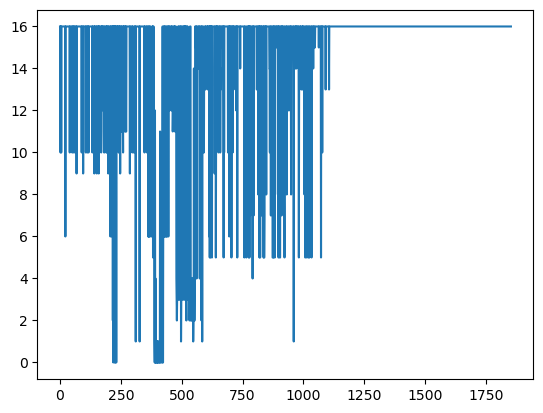

In [225]:
plt.plot(id_clusters)

In [226]:
task_len

array([['13770', 'arena'],
       ['3512', 'task_learning_inward_L_side'],
       ['4334', 'task_learning_inward_L_center'],
       ['1603', 'learning_inward_R_side'],
       ['2303', 'learning_inward_R_center'],
       ['2371', 'task_learning_outward_L_side'],
       ['2072', 'task_learning_outward_L_center'],
       ['955', 'learning_outward_R_side'],
       ['977', 'learning_outward_R_center'],
       ['2720', 'task_learned_inward_L_side'],
       ['3329', 'task_learned_inward_L_center'],
       ['3279', 'learned_inward_R_side'],
       ['3543', 'learned_inward_R_center'],
       ['3231', 'task_learned_outward_L_side'],
       ['2558', 'task_learned_outward_L_center'],
       ['3339', 'learned_outward_R_side'],
       ['2786', 'learned_outward_R_center'],
       ['6360', 'learning_sampling_L'],
       ['1579', 'learning_sampling_R'],
       ['4476', 'learned_sampling_L'],
       ['2805', 'learned_sampling_R'],
       ['15977', 'learning_reward_L'],
       ['7570', 'learning_reward_R

In [9]:
bins

array([-1,  0,  1,  2])

In [52]:
tsk_name

['arena',
 'task_learning_inward_L_side',
 'task_learning_inward_L_center',
 'learning_inward_R_side',
 'learning_inward_R_center',
 'task_learning_outward_L_side',
 'task_learning_outward_L_center',
 'learning_outward_R_side',
 'learning_outward_R_center',
 'task_learned_outward_L_side',
 'task_learned_outward_L_center',
 'learned_outward_R_side',
 'learned_outward_R_center',
 'task_learned_inward_L_side',
 'task_learned_inward_L_center',
 'learned_inward_R_side',
 'learned_inward_R_center',
 'learning_sampling_L',
 'learning_sampling_R',
 'learned_sampling_L',
 'learned_sampling_R',
 'learning_reward_L',
 'learning_reward_R',
 'learned_reward_L',
 'learned_reward_R',
 'sleep']

In [209]:
fig_hst=plt.figure(figsize=(5,25))
params = {"text.color" : "blue"}
plt.rcParams.update(params)

<Figure size 500x2500 with 0 Axes>

In [235]:
import colorsys
def get_N_HexCol(N=5):
    HSV_tuples = [(x*3.0/N, 1-x*.5/N, 1-x*1/N) for x in range(N)]
    #HSV_tuples = [(x*.20/N, x*.5/N, x*2/N) for x in range(N)]

    tuples = [(x * 1.0 / N, 1-x * .5 / N, .5+x * .5 / N, 1) for x in range(N)]

    hex_out = []
    for rgb in HSV_tuples:
        rgb = map(lambda x: int(x * 255), colorsys.hsv_to_rgb(*rgb))
        hex_out.append('#%02x%02x%02x' % tuple(rgb))
    return hex_out,tuples


N=len(np.unique(id_clusters))+1   
N=20
colorlist,colorlist_nbr = get_N_HexCol(N)

In [236]:
colorlist[-1]='#E5E5E5'# make bad cluster gray

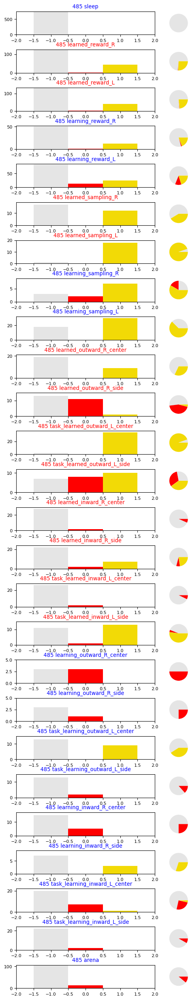

In [237]:

# plot distiribution of clusters for each task
tsk_len=np.cumsum(np.array([int(x[0]) for x in task_len]))
tsk_name=[x[1] for x in task_len]
i0=0
hists=[]
bins=np.arange(np.min(id_clusters),np.max(id_clusters))
fig_hst=plt.figure(figsize=(5,25))

with plt.rc_context({'font.size': 8}):
    for i in range(len(tsk_len)):
        ax=fig_hst.add_axes([0,i/len(tsk_len),.7,1/len(tsk_len)-.015])
        msk=(np.array(id_peaks)>i0) & (np.array(id_peaks)<tsk_len[i])
        labels, counts = np.unique(id_clusters[msk], return_counts=True)


        plt.bar(labels, counts, align='center',width=1,color=np.asanyarray(colorlist)[labels])
        plt.xlim([np.min(id_clusters)-1,np.max(id_clusters)+1])
        plt.ylim([0,np.max(counts)+2])

        ax2=fig_hst.add_axes([.72,i/len(tsk_len),.2,1/len(tsk_len)-.015])
        ax2.pie(counts,colors=np.asanyarray(colorlist)[labels],wedgeprops   = { 'linewidth' : .1,'edgecolor' : "white" })
        #hists.append(plt.hist(id_clusters[msk],bins=bins,alpha=.4,align='left')[0])
        if 'learned' in tsk_name[i]:
            ax.set_title(name[:3]+' '+ tsk_name[i],color='red')
            
        else:
             ax.set_title(name[:3]+' '+ tsk_name[i],color='blue')



        i0=tsk_len[i]
    plt.savefig(savefolder+name+'cluster distribution.png',bbox_inches='tight')

In [238]:
def concate_data(STMx):
    a = np.array([[]] * np.shape(STMx[0])[0])  
    for x in STMx:
        if x.shape[1]>0:
            a=np.column_stack((a,x))# data of all conditions in one matrix
    return a


In [106]:
# session_time = []
# session_time.append(0)
# session_time.extend(session_len)
# session_len_new=[]
# data_dict={}
# i0=0
# names_task=[]
# tasks=['arena','learning_outward','learning_inward','learned_outward','learned_inward'
              
#               ,'learning_reward_L','learning_reward_R','learned_reward_L','learned_reward_R'
#        ,'sleep']
# spk_task=[]
# for tsk in tasks:
#     for ni,nme in enumerate(names):
#         if tsk in nme:
#             names_task.append(nme)
#             spk_task.append(spks[:,session_time[ni]:session_time[ni+1]])
#             session_len_new.append(session_time[ni+1]-session_time[ni])

# spk2=concate_data(spk_task)

# session_len=np.cumsum(session_len_new)
# sp  = zscore(spk2, axis=1)
# names = names_task

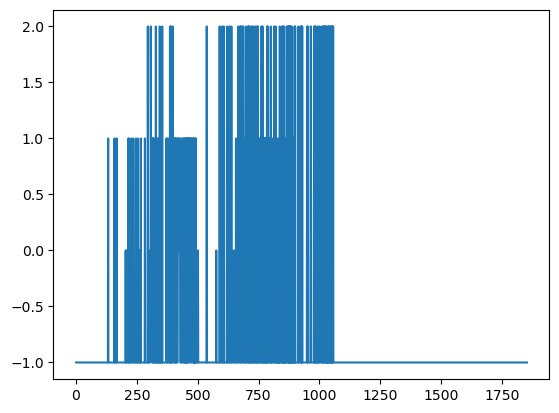

In [13]:
plt.plot(id_clusters)

In [6]:
# download 2-photon data (from hannah dataset 485)
# savefolder ='C:/Users/hamed/Desktop/Hamed/Github/TP7/results/'
# folders=['485']
# name='485arena all 485transients'
# filname=savefolder+name
# dat = np.load(filname,allow_pickle=True)
# sp  = zscore(dat, axis=1)
# sp.shape



In [7]:
        rgb = map(lambda x: int(x * 255), colorsys.hsv_to_rgb(*rgb))
        hex_out.append('#%02x%02x%02x' % tuple(rgb))

NameError: name 'colorsys' is not defined

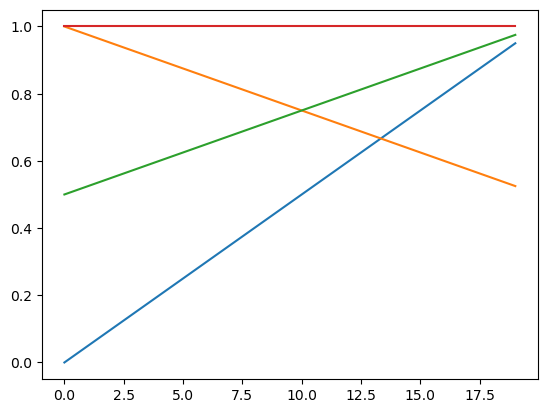

In [21]:
cmap

In [6]:


import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris

iris = load_iris()

In [150]:

# use plt.cm.get_cmap(cmap, N) to get an N-bin version of cmap
plt.scatter(iris.data[:, 0], iris.data[:, 1], s=30,
            c=iris.target, cmap=plt.cm.get_cmap('Greens', 3))

# This function formatter will replace integers with target names
formatter = plt.FuncFormatter(lambda val, loc: iris.target_names[val])

# We must be sure to specify the ticks matching our target names
plt.colorbar(ticks=[0, 1, 2], format=formatter);

# Set the clim so that labels are centered on each block
plt.clim(-0.5, 2.5)

NameError: name 'iris' is not defined

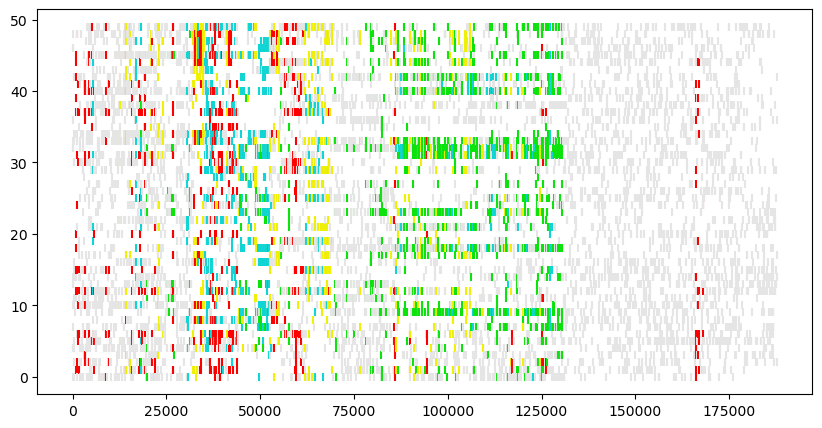

In [200]:
figs=plt.figure(figsize=(10,5))
colorlist[-1]='#E5E5E5'# make bad cluster gray
for ix,seq in enumerate(seqs):
    a=np.arange(len(seq))/len(seq)+id_peaks[ix]
    plt.scatter(a,seq,marker='|',color = colorlist[id_clusters[ix]])
    

#plt.plot((poprate/np.max(poprate)*sp.shape[0]),alpha=.2)
#plt.vlines(id_peaks,0,sp.shape[0],alpha=.5)
#plt.xlim([100,16000])
#plt.colorbar(cmap=colorlist)

# create a second axes for the colorbar


In [5]:
# import numpy as np
# import matplotlib.pyplot as plt
# from matplotlib import cm
# from matplotlib.colors import ListedColormap, LinearSegmentedColormap
# N=len(np.unique(id_clusters))+1
# viridis = cm.get_cmap('gray_r', N+1)
# newcolors = viridis(np.linspace(0, 1, N+1))
# pink = np.array([248/256, 24/256, 148/256, 10])
# newcolors[-N:, :] = colorlist_nbr
# #newcolors[N:, :] = pink

# newcmp = ListedColormap(newcolors)



# np.random.seed(19680801)
# data = np.random.randn(30, 30)


# plt.pcolormesh(data, cmap=newcmp, rasterized=True, vmin=0, vmax=10)
# plt.colorbar()

# fig, axs = plt.subplots(1, 2, figsize=(6, 3), constrained_layout=True)
# for [ax, cmap] in zip(axs, [viridis, newcmp]):
#     psm = ax.pcolormesh(data, cmap=cmap, rasterized=True, vmin=-4, vmax=4)
#     fig.colorbar(psm, ax=ax)
# plt.show()



In [239]:
task_len_cumsum= [(tsk_len[i], x[1]) for i, x in enumerate(task_len)]
# enter task name to compute the rastermap
task='all'

def task_data(task_len_cumsum,task):

    for i,leni in enumerate(task_len_cumsum):
        if task in leni[1]:
            task_idx= task_len_cumsum[i-1][0], task_len_cumsum[i][0]# index of the data time pints for each task
            
    if task =='arena':
        task_idx=0,task_len_cumsum[0][0]

    if task=='all':
        task_idx=0,tsk_len[-1]
    return task_idx

task_idx = task_data(task_len_cumsum,task=task) 
print(task, task_idx)
np.shape(sp[:,task_idx[0]:task_idx[1]])



all (0, 186416)


(51, 186416)

In [2]:

# figs=plt.figure(figsize=(50,20))

# ax2=figs.add_axes([0.01,.01,0.9,.9])
# seqmat = np.zeros((spks.shape[0],spks.shape[1]*seqmax))
# for ix in range(len(seqs)):
#         tx=seqs[ix]
#         ty=id_peaks[ix]+np.arange(0,len(seqs[ix]))+seqmax
#         seqmat[tx,ty] = 1
# ax2.imshow(seqmat,vmin =0, vmax=.01, cmap='binary',aspect='auto')
# #plt.plot(poprate)
# plot_sequence_time=True

In [240]:

# rastermap algorithm
# import sys
# sys.path.append('C:/Users/hamed/Desktop/Hame/test/rastermap')
# import mapping, imp
# imp.reload(mapping)


model = Rastermap(n_components=1, n_X=32).fit(sp[:,task_idx[0]:task_idx[1]])# compute raster map based on the data of task x
# compute correlation between speed and each cells activity

isort = np.argsort(model.embedding[:,0])
#Sfilt = running_average(sp[isort, :], 2)
Sfilt=sp[isort, :]
Sfilt = stats.zscore(Sfilt, axis=1)
new_seqs=[]
for seq in seqs:
    new_seqs.append(np.ravel([np.where(isort==x)[0] for x in seq]))# sorting seqs according to rastermap
#Sfilt=sp#[isort, :]


nmin 51
0.02634143829345703
0.6278946399688721
0.7126674652099609
0.7136662006378174
(30, 32)
(62,)
1.0
time; iteration;  explained PC variance
0.00s     0        0.0507      2
0.01s    10        0.1354      4
0.01s    20        0.2318      8
0.02s    30        0.4028      18
0.03s    40        0.5488      28
0.03s    50        0.5754      30
0.04s    60        0.5754      30
0.04s   final      0.5754
0.04s upsampled    0.5754


In [51]:
lag=np.arange(-10,10,1)

task_idx2=(task_idx[0]+abs(lag[0]),task_idx[1]-lag[-1])



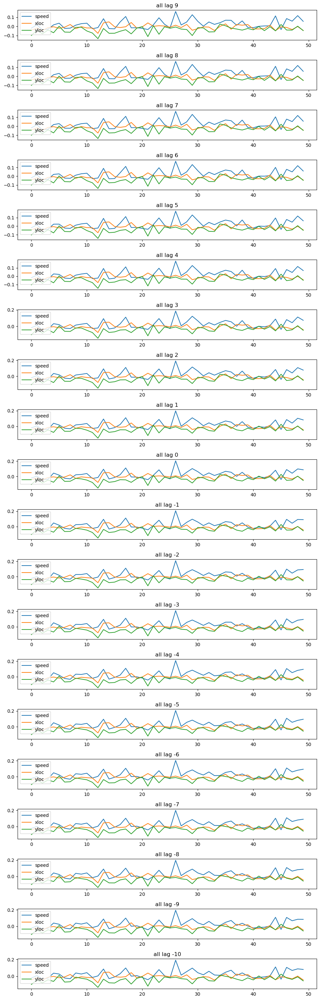

Maximum abs(corr) at lag  -3  is 0.21 cell nubmer is  26 from behaveiral signal speed


In [52]:
# compute crrelation between behavioral variables and sorted signal
if task=='all':
    task_idx=task_idx2
lagged_corr=[]
lfig=plt.figure(figsize=(10,30))
lag=np.arange(-10,10,1)
labels=['speed','xloc','yloc']
for il,lg in enumerate(lag):
    speed_corr = [np.corrcoef(x[task_idx[0]:task_idx[1]], speed[task_idx[0]+lg:task_idx[1]+lg])[0][1] for x in Sfilt]
    xloc_corr = [np.corrcoef(x[task_idx[0]:task_idx[1]], locations[0,task_idx[0]+lg:task_idx[1]+lg])[0][1] for x in Sfilt]
    yloc_corr = [np.corrcoef(x[task_idx[0]:task_idx[1]], locations[1,task_idx[0]+lg:task_idx[1]+lg])[0][1] for x in Sfilt]
    corrs=np.array([speed_corr,xloc_corr,yloc_corr])
    lagged_corr.append(corrs)

    ax = lfig.add_axes([0.01,il/len(lag),.9,1/len(lag)-.02])
    ax.plot(speed_corr,label='speed')
    ax.plot(xloc_corr,label='xloc')
    ax.plot(yloc_corr,label='yloc')
    ax.set_title(task+ ' lag '+ str(lg))
    plt.legend()
plt.show()

cormax=[np.max(x) for x in lagged_corr]

cormax_cell=[np.argmax(np.max(abs(x),axis=0)) for x in lagged_corr ]
cormax_beh=np.argmax(abs(lagged_corr[np.argmax(cormax)][:,cormax_cell[np.argmax(cormax)]]))


print('Maximum abs(corr) at lag ',lag[np.argmax(cormax)],' is %.2f' %np.max(cormax), 'cell nubmer is ',cormax_cell[np.argmax(cormax)],'from behaveiral signal',labels[cormax_beh])




In [53]:
speed_=np.array(speed[task_idx[0]:task_idx[1]])
#xloc=np.array(locations[0,task_idx[0]:task_idx[1]])
#yloc=np.array(locations[1,task_idx[0]:task_idx[1]])
locations_=np.array(locations[:,task_idx[0]:task_idx[1]])
poprate_=np.array(poprate[task_idx[0]:task_idx[1]])
behav=np.row_stack((speed_,locations_))
behav_=np.row_stack((locations_,poprate_))
behav_ -= np.mean(behav_,axis=1)[:,np.newaxis]
behavzs_=zscore(behav_)

In [54]:
NN, NT = sp.shape 

# reshape and sum S across neurons to get "components"
nc = 100
NC = int(np.floor(NN / nc))
Sp = np.reshape(sp[isort][:nc*NC], (NC, nc, NT))
Sp = Sp.mean(axis=1)

In [55]:
# bin data
poprate-=np.nanmean(poprate)
#speed=poprate

tbin = 3.0
NT = speed_.shape[0]
nt = int(np.floor(NT/tbin))
#motSVD -= motSVD.mean(axis=1)[:,np.newaxis]
#speed  -= np.nanmean(poprate)
speed_[np.isnan(speed_)] = 0
tbin = int(tbin)

beh = np.reshape(behavzs_[:,:nt*tbin], (behavzs_.shape[0], nt, tbin)).mean(axis=-1)
pup = np.reshape(behav[cormax_beh][:nt*tbin], (nt, tbin)).mean(axis=-1)

# using this format bin S
Sbin = np.reshape(sp[:,:nt*tbin], (sp.shape[0], nt, tbin)).mean(axis=-1)
Spbin = np.reshape(Sp[:,:nt*tbin], (Sp.shape[0], nt, tbin)).mean(axis=-1)

# use PCs of neural activity
model = PCA(n_components=32).fit(Sbin)
V = model.components_ # time components
sv = model.singular_values_
U = np.matmul(Sbin,V.T) / sv # neuron components
V *= sv[:,np.newaxis]

In [ ]:
# split into train-test
# * use interleaved segments *
nsegs = 20
nlen  = nt/nsegs
ninds = np.linspace(0,nt-nlen,nsegs).astype(int)
itest = (ninds[:,np.newaxis] + np.arange(0,nlen*0.25,1,int)).flatten()
itrain = np.ones(nt, np.bool)
itrain[itest] = 0

#plt.plot(itrain)
#plt.show()

C:\Users\hamed\AppData\Local\Temp\ipykernel_15492\265005618.py:7: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  itrain = np.ones(nt, np.bool)


In [ ]:

#### PREDICT USING PUPIL WITH LINEAR REGRESSION

A = np.matmul(pup[itrain], V[:,itrain].T)/(pup**2).sum()

Vpredp = np.matmul(A[:,np.newaxis], pup[itest][np.newaxis,:])

varexp_pupil = 1 - ((Vpredp - V[:,itest])**2).sum(axis=1)/(V[:,itest]**2).sum(axis=1)
#### PREDICT USING BEHAVIOR PC'S 
## regularized linear regression from behavior to neural PCs
covM = np.matmul(beh[:,itrain], beh[:,itrain].T)
lam = 1e5 # regularizer
covM += lam*np.eye(beh.shape[0])
A = np.linalg.solve(covM, np.matmul(beh[:,itrain], V[:,itrain].T))

Vpred = np.matmul(A.T, beh[:,itest])

varexp = 1 - ((Vpred - V[:,itest])**2).sum(axis=1)/(V[:,itest]**2).sum(axis=1)

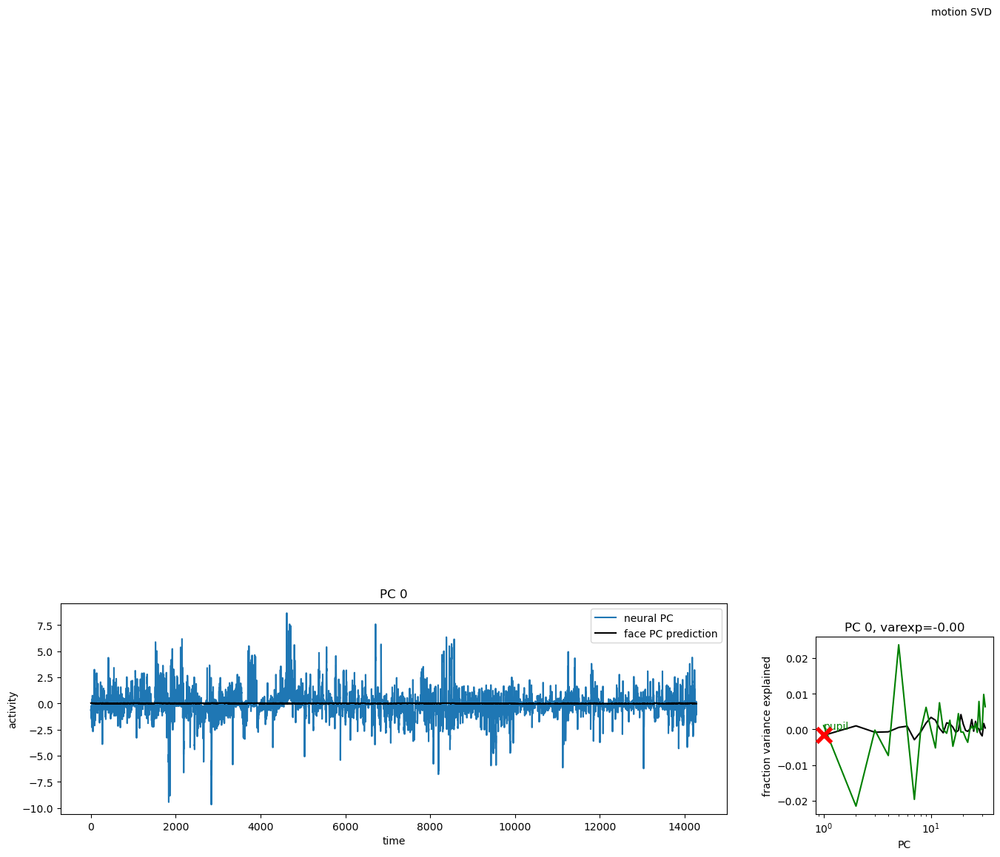

In [ ]:
# plot of principal component activity and variance explained

fig=plt.figure(figsize=(12,3))

ipc = 0 ### which PC to plot

ax = fig.add_axes([0.05,.05,.75,.95])
ax.plot(V[ipc,itest], label='neural PC')
ax.plot(Vpred[ipc], color='k', label='face PC prediction')
ax.set_title('PC %d'%ipc)
ax.set_xlabel('time')
ax.set_ylabel('activity')
ax.legend()

ax = fig.add_axes([0.9,.05, .2, .8])
ax.semilogx(np.arange(1,varexp.size+1), varexp, color='k')
ax.scatter(ipc+1, varexp[ipc],marker='x',color='r',s=200, lw=4, zorder=10)
ax.semilogx(np.arange(1,varexp.size+1), varexp_pupil, color=[0.,.5,0])
ax.text(1,0,'pupil',color=[0,.5,0])
ax.text(10,0.2,'motion SVD')
ax.set_xlabel('PC')
ax.set_ylabel('fraction variance explained')
ax.set_title('PC %d, varexp=%0.2f'%(ipc,varexp[ipc]))
plt.show()

In [14]:
# Sfilt2= np.zeros_like(Sfilt)
# for i,idpk in enumerate(id_peaks):
#     Sfilt2[seqs[i],idpk]=id_clusters[i]

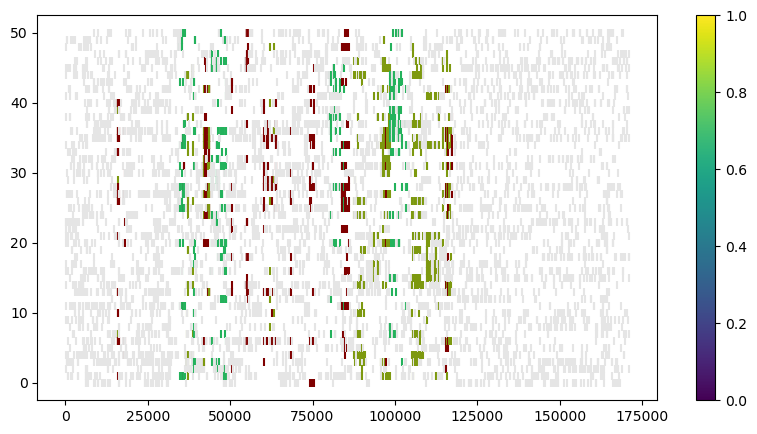

In [32]:


figs=plt.figure(figsize=(10,5))
for ix,seq in enumerate(new_seqs):
    a=np.arange(len(seq))/len(seq)+id_peaks[ix]
    plt.scatter(a,seq,marker='|',color = colorlist[id_clusters[ix]])
#plt.plot((poprate/np.max(poprate)*sp.shape[0]),alpha=.2)
#plt.vlines(id_peaks,0,sp.shape[0],alpha=.5)
#plt.xlim([100,16000])
plt.colorbar(cmap=colorlist)

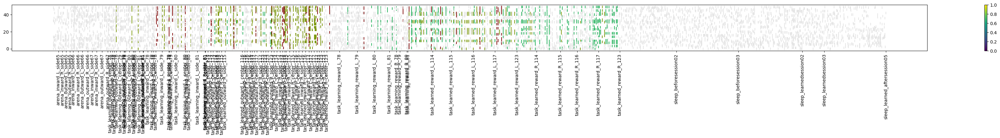

In [20]:
fig=plt.figure(figsize=(40,5))
ax2=fig.add_axes([0.01,.62,0.9,.29])
for ix,seq in enumerate(seqs):
    a=np.arange(len(seq))/len(seq)+id_peaks[ix]
    plt.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
plt.xticks(session_len, names, rotation=90)
plt.colorbar()
plt.show()

In [103]:
len(session_len2)

TypeError: object of type 'numpy.int32' has no len()

In [112]:
names_

['arena_inward_L_side65',
 'arena_inward_R_side65',
 'arena_outward_L_side65',
 'arena_outward_R_side65',
 'arena_inward_L_side66',
 'arena_inward_R_side66',
 'arena_outward_L_side66',
 'arena_outward_R_side66',
 'arena_inward_L_side67',
 'arena_inward_R_side67',
 'arena_outward_L_side67',
 'arena_outward_R_side67',
 'task_learning_outward_L_center_78',
 'task_learning_outward_L_side_78',
 'task_learning_outward_R_center_78',
 'task_learning_outward_R_side_78',
 'task_learning_outward_L_center_79',
 'task_learning_outward_L_side_79',
 'task_learning_outward_R_center_79',
 'task_learning_outward_R_side_79',
 'task_learning_outward_L_center_80',
 'task_learning_outward_L_side_80',
 'task_learning_outward_R_center_80',
 'task_learning_outward_R_side_80',
 'task_learning_outward_L_center_81',
 'task_learning_outward_L_side_81',
 'task_learning_outward_R_center_81',
 'task_learning_outward_R_side_81',
 'task_learning_inward_L_side_78',
 'task_learning_inward_L_center_78',
 'task_learning_in

In [113]:
tsk_name

['arena',
 'learning_outward',
 'learning_inward',
 'learned_outward',
 'learned_inward',
 'learning_reward_L',
 'learning_reward_R',
 'learned_reward_L',
 'learned_reward_R',
 'sleep']

In [38]:
[x for x in names if 'sleep' in x]

['sleep_beforesession02',
 'sleep_beforesession03',
 'sleep_learnedsession02',
 'sleep_learnedsession03',
 'sleep_learned_aftersession05']

In [269]:
np.array(session_len_learned).astype(int)

array([ 44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,  55,  56,
        57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,  68,  69,
        70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,  82,
        83,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 110, 111,
       112, 113, 114, 115, 116, 117, 118, 119, 122, 123])

In [278]:
ax2.get_xticklabels()[np.arange(10)]

TypeError: only integer scalar arrays can be converted to a scalar index

In [285]:
for x in session_len_learned:
    ax2.get_xticklabels()[x].set_color("red")


In [282]:

maskx=np.zeros(len(names),dtype=bool)
maskx[session_len_learned]=True

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False, False, False, False, False, False,
       False, False,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False, False, False, False, False, False,
       False, False,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False, False,  True,  True])

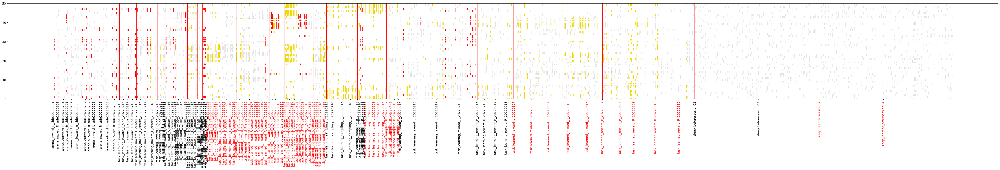

Text(0.5, 1.0, '485inedx_corrected_merged')

In [286]:
sum_session=[]
for nme in tsk_name:

    sum_session.append((np.array([session_len[i] for i, x in enumerate(names) if nme in x ])[-1]))
session_len2=np.insert(session_len,0,0)
session_len2=session_len2[:-1]
max_seq= np.max(np.array([np.max(x) for x in new_seqs]))
fig=plt.figure(figsize=(50,15))
ax2=fig.add_axes([0.01,.62,0.9,.29])
for ix,seq in enumerate(new_seqs):
    a=np.arange(len(seq))/len(seq)+id_peaks[ix]
    ax2.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])

session_len_learned=[i for i, x in enumerate(names) if 'learned' in x ]    
ax2.set_xticks(session_len2, names, rotation=90,color='black')


for x in session_len_learned:
    ax2.get_xticklabels()[x].set_color("red")

# plt.xticks(session_len2, names, rotation=90,color='red')
# plt.xticks(session_len2, names, rotation=90,color='black')

#plt.colorbar()
plt.vlines(sum_session,0,max_seq,'r')
plt.ylim([0,max_seq])
plt.show()
ax2.set_title(name)

In [46]:
# a2=np.mean(Sfilt2,axis=0)
# plt.plot(a2)

In [306]:
# import matplotlib.pyplot as plt
# import numpy as np

# def discrete_matshow(data):
#     # get discrete colormap
#     plt.figure(figsize=(100,10),dpi=80)
#     cmap = plt.get_cmap('RdBu', np.max(data) - np.min(data) + 1)
#     # set limits .5 outside true range
#     mat = plt.matshow(data,aspect='auto' ,cmap=newcmp, vmin=np.min(data) , 
#                       vmax=np.max(data) )
#     # tell the colorbar to tick at integers
#     cax = plt.colorbar(mat, ticks=np.arange(np.min(data), np.max(data) + 1))

# # generate data
# discrete_matshow(Sfilt3)

In [141]:
# figs=plt.figure(figsize=(25,40),dpi=80)


# ax0=figs.add_axes([0.01,.01,0.9,.6])
# from matplotlib import cm
# n_colors = N
# colours = cm.rainbow(np.linspace(0, 1, n_colors))

# #ax0.imshow(Sfilt, vmin = 0, vmax=3, aspect='auto', origin='lower',cmap='gray_r',interpolation=None)
# ax0.imshow(Sfilt3, vmin = 48, vmax=50, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)
# plt.show()
# plt.colorbar()
# #plt.colorbar(mat, ticks=np.arange(np.min(Sfilt2), np.max(Sfilt2) + 1))


In [47]:
# for ix,seq in enumerate(seqs):
#     #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
#     #plt.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
#     plt.vlines(id_peaks[ix],0,np.shape(Sfilt)[0],color=colorlist[id_clusters[ix]],alpha=.3)
# plt.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=.2)
# plt.xticks(session_len, names, rotation=90)

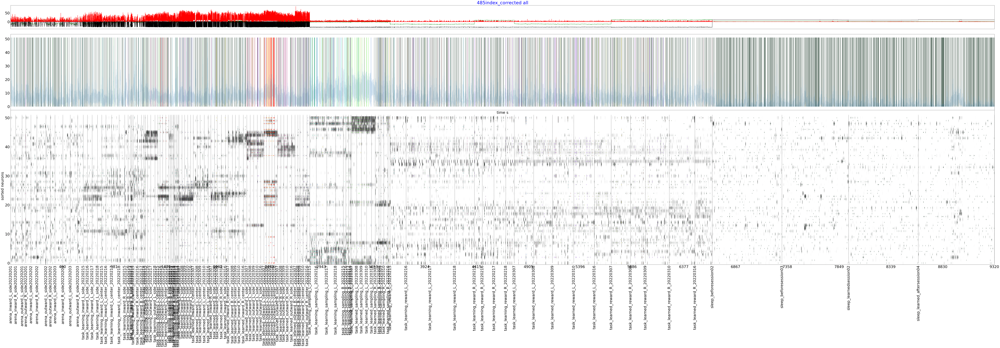

In [233]:

session_len_xtic=np.insert(session_len,0,0)
session_len_xtic=session_len_xtic[:-1]

# the manifold embedding is in model.embedding
fs=20
# sort by embedding and smooth over neurons
#Sfilt = running_average(sp[isort, :], 3)
Sfilt = stats.zscore(Sfilt, axis=1)
xtick_time=np.linspace(0,np.shape(Sfilt)[1],20)
xtick_time_label=(xtick_time/fs)
#xtick_time_label=("["+', '.join(['%.0f']*len(xtick_time_label))+"]") % tuple(xtick_time_label)
figs=plt.figure(figsize=(125,30),dpi=80)

with plt.rc_context({'font.size': 31}):
       ax0=figs.add_axes([0.01,.01,0.9,.6])
       ax2=figs.add_axes([0.01,.6,0.9,.29])


       ax0.imshow(Sfilt, vmin =0, vmax=3, aspect='auto', cmap='gray_r',origin='lower',alpha=.7)
       plt.xlabel('time s')
       ax0.set_ylabel('sorted neurons')
       #plt.vlines(np.cumsum(trial_len)  ,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=.5)
       ax0.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=2,colors='k', linestyles='dashed',alpha=.5)
       ax0.set_xticks(session_len_xtic, names, rotation=90)  # Set text labels and properties.
       ax0.set_xticks(xtick_time, xtick_time_label.astype(int), minor=True)  # Set text labels and properties.
       ax0.set_xlim([0,len(locations[1,:])])
       ax1=figs.add_axes([0.01,.91,0.9,.09])
       ax1.plot((locations[0,:]),'g')
       ax1.plot((locations[1,:]),'k')
       ax1.plot(speed,'r')
       ax1.set_xlim([0,len(locations[1,:])])
       ax1.set_xticks([])
       ax1.set_title(name+' '+task)
       for ix,seq in enumerate(seqs):
          #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          #ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
          ax2.vlines(id_peaks[ix],0,np.shape(Sfilt)[0],color=colorlist[id_clusters[ix]],alpha=.7)
       
       #ax0.imshow(Sfilt2, vmin = 0, vmax=N+1, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)
       #ax0.imshow(Sfilt2, vmin = 0, vmax=.010, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)

       
       for ix,seq in enumerate(new_seqs):
          a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
       ax2.set_xticks([])
       #ax2.set_yticks([])
       ax2.set_xlim([0,len(locations[1,:])])
       ax2.plot(poprate/np.max(poprate)*sp.shape[0],alpha=.2)

       #ax0.set_xlim([100,1000])
       #plt.title(name)
       #plt.savefig(savefolder+name+'.pdf',bbox_inches='tight')
       #plt.savefig(savefolder+name+' '+task+'.png',bbox_inches='tight')
       plt.show(block=0)

NameError: name 'xtick_corrected' is not defined

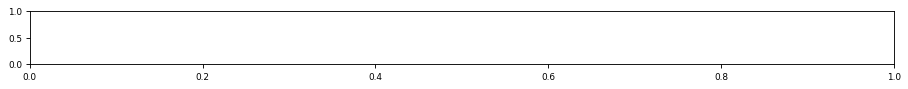

In [167]:

figs=plt.figure(figsize=(12,26),dpi=80)
offset=1/len(tsk_name)-1/len(tsk_name)/3
offset0=1/len(tsk_name)-1/len(tsk_name)/1.1
with plt.rc_context({'font.size': 8}):
   for it, task_name in enumerate(tsk_name):
      if it>1:
         break
      ax0=figs.add_axes([0.01,it/len(tsk_name),0.9,offset])
      ax0.vlines(xtick_corrected,0,np.shape(Sfilt)[0],linewidth=2,colors='k', linestyles='dashed',alpha=.5)

      for ix,seq in enumerate(np.array(new_seqs)[id_peaks_mask]):
         a=np.arange(len(seq))/len(seq)+np.array(id_peaks)[id_peaks_mask][ix]-it2
         ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[id_peaks_mask][ix]],alpha=.7)

      ax2=figs.add_axes([0.01,it/len(tsk_name)+offset,0.9,offset0])
      #ax1=figs.add_axes([0.01,it/len(tsk_name)-1/len(tsk_name)/3,0.9,1/len(tsk_name)-1/len(tsk_name)/1.5])

C:\Users\hamed\AppData\Local\Temp\ipykernel_20064\3501714555.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  for ix,seq in enumerate(np.array(new_seqs)[id_peaks_mask]):


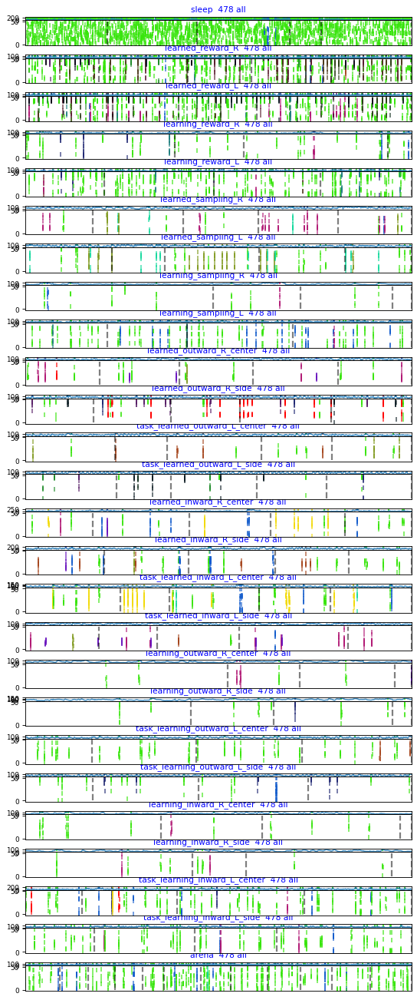

In [168]:
colorlist,colorlist_nbr = get_N_HexCol(N=len(np.unique(id_clusters))+1)
#colorlist[-1]='#E5E5E5'# make bad cluster gray

#session_len_xtic=np.insert(session_len,0,0)
#session_len_xtic=session_len_xtic[:-1]
session_len_xtic = session_len
trialpoints= np.cumsum(trial_len)
figs=plt.figure(figsize=(7,16),dpi=80)
it0=0
it2=0

with plt.rc_context({'font.size': 8}):
   for it, task_name in enumerate(tsk_name):
      # if it>20:
      #    break
      data_tsk_idx= task_data(task_len_cumsum,task_name)
      ax0=figs.add_axes([0.01,it/len(tsk_name),0.9,offset])
      xtickmask= (session_len_xtic>data_tsk_idx[0]) & (session_len_xtic<=data_tsk_idx[1])
      trlmask= (trialpoints>data_tsk_idx[0]) & (trialpoints<=data_tsk_idx[1])

      trialpoints_corrected= trialpoints[trlmask]-it0
      xtick_corrected = session_len_xtic[xtickmask]-it0
      it0 = session_len_xtic[xtickmask][-1]
      #xtick_corrected = np.insert(xtick_corrected,0,0)
      #xtick_corrected = xtick_corrected[:-1]
      #ax0.imshow(Sfilt[:,data_tsk_idx[0]:data_tsk_idx[1]], vmin =0, vmax=3, aspect='auto', cmap='gray_r',origin='lower',alpha=.7)
      #ax0.set_xticks(xtick_corrected, np.array(list(names))[xtickmask], rotation=90)  # Set text labels and properties.
      
      ax0.vlines(xtick_corrected,0,np.shape(Sfilt)[0],linewidth=2,colors='k', linestyles='dashed',alpha=.5)
      #plt.vlines(  trialpoints_corrected,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=.5)
      #ax0.set_xticks(xtick_time[xtickmask], xtick_time_label[xtickmask].astype(int), minor=True)  # Set text labels and properties.
      id_peaks_mask= (np.array(id_peaks)>data_tsk_idx[0]) & (np.array(id_peaks)<=data_tsk_idx[1])
      ax0.set_xlim([0,data_tsk_idx[1]-data_tsk_idx[0]])

      id_clusters[id_peaks_mask]


      ax2=figs.add_axes([0.01,it/len(tsk_name)+offset,0.9,offset0])

      #ax2=figs.add_axes([0.01,it/len(tsk_name)+.065/5,0.9,1/len(tsk_name)-.09/5])


      for ix,seq in enumerate(np.array(new_seqs)[id_peaks_mask]):
         a=np.arange(len(seq))/len(seq)+np.array(id_peaks)[id_peaks_mask][ix]-it2
         ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[id_peaks_mask][ix]],alpha=.7)
         ax2.vlines(np.array(id_peaks)[id_peaks_mask][ix]-it2,np.mean(poprate[data_tsk_idx[0]:data_tsk_idx[1]]),np.max(poprate[data_tsk_idx[0]:data_tsk_idx[1]]),color=colorlist[id_clusters[id_peaks_mask][ix]],alpha=1)
      #it2=np.array(id_peaks)[id_peaks_mask][-1]
      it2=data_tsk_idx[1]



      # ax1=figs.add_axes([0.01,it/len(tsk_name)-1/len(tsk_name)/3,0.9,1/len(tsk_name)-1/len(tsk_name)/1.5])
      # #ax1=figs.add_axes([0.01,it/len(tsk_name)-.015/15,0.9,1/len(tsk_name)-.09/5])
      # ax1.plot((locations[0,data_tsk_idx[0]:data_tsk_idx[1]]),'g')
      # ax1.plot((locations[1,data_tsk_idx[0]:data_tsk_idx[1]]),'k')
      # ax1.plot(speed[data_tsk_idx[0]:data_tsk_idx[1]],'r')
      # ax1.set_xlim([0,data_tsk_idx[1]-data_tsk_idx[0]])


      ax2.plot(poprate[data_tsk_idx[0]:data_tsk_idx[1]],alpha=.8)
      ax2.set_xlim([0,data_tsk_idx[1]-data_tsk_idx[0]])
      ax2.set_title(task_name+'  '+name[:3]+' '+task)
      ax2.set_xticks([])
      ax0.set_xticks([])
      #for ix,seq in enumerate(seqs):
          #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          #ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
          

      # for ix,seq in enumerate(np.array(seqs)[id_peaks_mask]):
      #    #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
      #    #ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
      #    ax2.vlines(id_peaks[id_peaks_mask][ix],0,np.shape(Sfilt)[0],color=colorlist[id_clusters[id_peaks_mask][ix]],alpha=.7)



#plt.savefig(savefolder+name+' '+task+' vertical.png',bbox_inches='tight')
plt.show(block=0)


In [160]:
new_Seqs=[]
for seq in Seqs:
    new_Seqs.append(np.ravel([np.where(isort==x)[0] for x in seq]))# sorting seqs according to rastermap

In [104]:
tsk_name

['arena',
 'learning_outward',
 'learning_inward',
 'learned_outward',
 'learned_inward',
 'learning_reward_L',
 'learning_reward_R',
 'learned_reward_L',
 'learned_reward_R',
 'sleep']

In [113]:
task_len_cumsum

[(11583, 'arena'),
 (19171, 'learning_outward'),
 (32424, 'learning_inward'),
 (46517, 'learned_outward'),
 (58263, 'learned_inward'),
 (71631, 'learning_reward_L'),
 (75606, 'learning_reward_R'),
 (98877, 'learned_reward_L'),
 (120800, 'learned_reward_R'),
 (177608, 'sleep')]

In [114]:
data_tsk_idx

(32424, 46517)

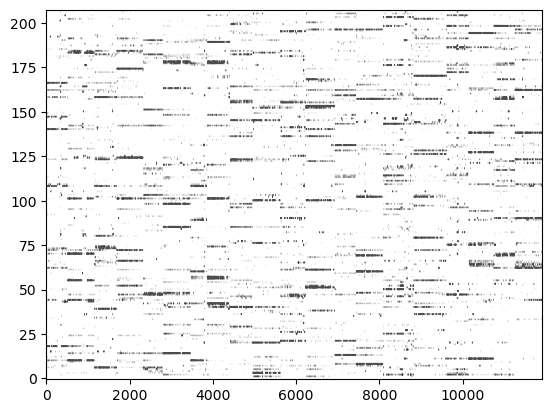

In [161]:
task_name='learned_outward'
it=3
data_tsk_idx= task_data(task_len_cumsum,task_name)
plt.imshow(sp[:,data_tsk_idx[0]:data_tsk_idx[1]], vmin =0, vmax=3, aspect='auto', cmap='gray_r',origin='lower',alpha=.7)

In [109]:
(data_tsk_idx)

(32424, 46517)

C:\Users\hamed\AppData\Local\Temp\ipykernel_8520\364495162.py:41: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  for ix,seq in enumerate(np.array(new_Seqs)[id_peaks_mask]):


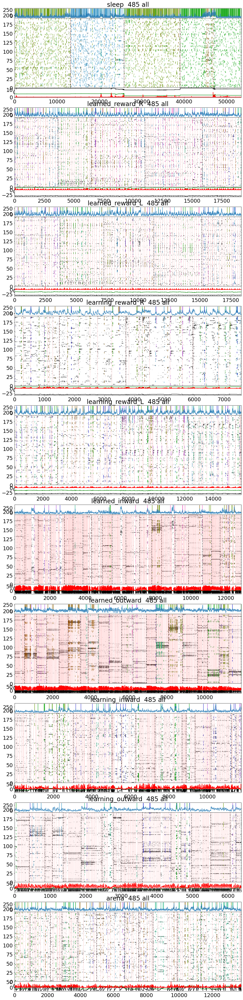

In [162]:
# similar vertical plot but this time for clusters of each session NOT alls data 

session_len_xtic = session_len
trialpoints= np.cumsum(trial_len)
figs=plt.figure(figsize=(14,55),dpi=80)
it0=0
it2=0
colorlist,colorlist_nbr = get_N_HexCol(N=len(np.unique(Id_clusters))+1)

with plt.rc_context({'font.size': 21}):
   for it, task_name in enumerate(tsk_name):
      if it>20:
         break
      data_tsk_idx= task_data(task_len_cumsum,task_name)
      ax0=figs.add_axes([0.01,it/len(tsk_name)-.0055,0.9,1/len(tsk_name)-.02])
      xtickmask= (session_len_xtic>data_tsk_idx[0]) & (session_len_xtic<=data_tsk_idx[1])
      trlmask= (trialpoints>data_tsk_idx[0]) & (trialpoints<=data_tsk_idx[1])

      trialpoints_corrected= trialpoints[trlmask]-it0
      xtick_corrected = session_len_xtic[xtickmask]-it0
      it0 = session_len_xtic[xtickmask][-1]
      #xtick_corrected = np.insert(xtick_corrected,0,0)
      #xtick_corrected = xtick_corrected[:-1]
      ax0.imshow(Sfilt[:,data_tsk_idx[0]:data_tsk_idx[1]], vmin =0, vmax=3, aspect='auto', cmap='gray_r',origin='lower',alpha=.7)
      #ax0.set_xticks(xtick_corrected, np.array(list(names))[xtickmask], rotation=90)  # Set text labels and properties.
      
      ax0.vlines(xtick_corrected,0,np.shape(Sfilt)[0],linewidth=2,colors='k', linestyles='dashed',alpha=.5)
      plt.vlines(  trialpoints_corrected,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=.5)
      #ax0.set_xticks(xtick_time[xtickmask], xtick_time_label[xtickmask].astype(int), minor=True)  # Set text labels and properties.
      id_peaks_mask= (np.array(Id_peaks)>data_tsk_idx[0]) & (np.array(Id_peaks)<=data_tsk_idx[1])
      ax0.set_xlim([0,data_tsk_idx[1]-data_tsk_idx[0]])





      ax2=figs.add_axes([0.01,it/len(tsk_name)+.065,0.9,1/len(tsk_name)-.09])



      for ix,seq in enumerate(np.array(new_Seqs)[id_peaks_mask]):
         a=np.arange(len(seq))/len(seq)+np.array(Id_peaks)[id_peaks_mask][ix]-it2
         ax0.scatter(a,seq,marker='|',color=colorlist[Id_clusters[id_peaks_mask][ix]],alpha=.7)
         ax2.vlines(np.array(Id_peaks)[id_peaks_mask][ix]-it2,np.mean(poprate[data_tsk_idx[0]:data_tsk_idx[1]]),np.max(poprate[data_tsk_idx[0]:data_tsk_idx[1]]),color=colorlist[Id_clusters[id_peaks_mask][ix]],alpha=1)
      #it2=np.array(id_peaks)[id_peaks_mask][-1]
      it2=data_tsk_idx[1]




      ax1=figs.add_axes([0.01,it/len(tsk_name)-.015,0.9,1/len(tsk_name)-.09])
      ax1.plot((locations[0,data_tsk_idx[0]:data_tsk_idx[1]]),'g')
      ax1.plot((locations[1,data_tsk_idx[0]:data_tsk_idx[1]]),'k')
      ax1.plot(speed[data_tsk_idx[0]:data_tsk_idx[1]],'r')
      ax1.set_xlim([0,data_tsk_idx[1]-data_tsk_idx[0]])


      ax2.plot(poprate[data_tsk_idx[0]:data_tsk_idx[1]],alpha=.8)
      ax2.set_xlim([0,data_tsk_idx[1]-data_tsk_idx[0]])
      ax2.set_title(task_name+'  '+name[:3]+' '+task)
      ax2.set_xticks([])

      #for ix,seq in enumerate(seqs):
          #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          #ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
          

      # for ix,seq in enumerate(np.array(seqs)[id_peaks_mask]):
      #    #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
      #    #ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
      #    ax2.vlines(id_peaks[id_peaks_mask][ix],0,np.shape(Sfilt)[0],color=colorlist[id_clusters[id_peaks_mask][ix]],alpha=.7)



plt.savefig(savefolder+name+' '+task+' vertical session clusters.png',bbox_inches='tight')
plt.show(block=0)

In [ ]:

# the manifold embedding is in model.embedding
fs=20
# sort by embedding and smooth over neurons
#Sfilt = running_average(sp[isort, :], 3)
Sfilt = stats.zscore(Sfilt, axis=1)
xtick_time=np.linspace(0,np.shape(Sfilt)[1],20)
xtick_time_label=(xtick_time/fs)
figs=plt.figure(figsize=(15,30),dpi=80)

with plt.rc_context({'font.size': 31}):
       ax0=figs.add_axes([0.01,.01,0.9,.6])
       ax2=figs.add_axes([0.01,.6,0.9,.29])

       ax0.imshow(Sfilt, vmin =0, vmax=3, aspect='auto', cmap='gray_r',origin='lower',alpha=.7)
       plt.xlabel('time s')
       ax0.set_ylabel('sorted neurons')
       #plt.vlines(np.cumsum(trial_len)  ,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=.5)
       ax0.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=2,colors='k', linestyles='dashed',alpha=.5)
       ax0.set_xticks(session_len_xtic, names, rotation=90)  # Set text labels and properties.
       ax0.set_xticks(xtick_time, xtick_time_label.astype(int), minor=True)  # Set text labels and properties.
       ax0.set_xlim([0,len(locations[1,:])])
       ax1=figs.add_axes([0.01,.91,0.9,.09])
       ax1.plot((locations[0,:]),'g')
       ax1.plot((locations[1,:]),'k')
       ax1.plot(speed,'r')
       ax1.set_xlim([0,len(locations[1,:])])
       ax1.set_xticks([])
       ax1.set_title(name+' '+task)
       for ix,seq in enumerate(new_seqs):
          a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
       ax2.set_xticks([])
       #ax2.set_yticks([])
       ax2.set_xlim([0,len(locations[1,:])])
       ax2.plot(poprate/np.max(poprate)*sp.shape[0],alpha=.2)

       #ax0.set_xlim([100,1000])
       #plt.title(name)
       #plt.savefig(savefolder+name+'.pdf',bbox_inches='tight')
       plt.savefig(savefolder+name+' '+task+'.png',bbox_inches='tight')
       plt.show(block=0)

In [151]:


# the manifold embedding is in model.embedding
fs=20
# sort by embedding and smooth over neurons
#Sfilt = running_average(sp[isort, :], 3)
Sfilt = stats.zscore(Sfilt, axis=1)
xtick_time=np.linspace(0,np.shape(Sfilt)[1],20)
xtick_time_label=(xtick_time/fs)
#xtick_time_label=("["+', '.join(['%.0f']*len(xtick_time_label))+"]") % tuple(xtick_time_label)
figs=plt.figure(figsize=(50,40),dpi=80)

with plt.rc_context({'font.size': 51}):
       ax0=figs.add_axes([0.01,.01,0.9,.6])

       ax0.imshow(Sfilt, vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r',origin='lower')
       plt.xlabel('time s')
       ax0.set_ylabel('sorted neurons')
       plt.vlines(np.cumsum(trial_len)  ,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=.5)
       plt.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=2)
       ax0.set_xticks(session_len, names, rotation=90)  # Set text labels and properties.
       ax0.set_xticks(xtick_time, xtick_time_label.astype(int), minor=True)  # Set text labels and properties.
       ax0.set_xlim([0,len(locations[1,:])])
       ax1=figs.add_axes([0.01,.91,0.9,.09])
       ax1.plot((locations[0,:]),'g')
       ax1.plot((locations[1,:]),'k')
       ax1.plot(speed,'r')
       ax1.set_xlim([0,len(locations[1,:])])
       ax1.set_xticks([])
       ax1.set_title(name)
       for ix,seq in enumerate(seqs):
          #a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          #ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
          ax0.vlines(id_peaks[ix],0,np.shape(Sfilt)[0],color=colorlist[id_clusters[ix]],alpha=.3)
       
       #ax0.imshow(Sfilt2, vmin = 0, vmax=N+1, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)
       
       
       ax2=figs.add_axes([0.01,.62,0.9,.29])
       for ix,seq in enumerate(seqs):
          a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          ax2.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
       ax2.set_xticks([])
       #ax2.set_yticks([])
       ax2.set_xlim([0,len(locations[1,:])])
       ax2.plot(poprate/np.max(poprate)*sp.shape[0],alpha=.2)


       #plt.title(name)
       #plt.savefig(savefolder+name+'.pdf',bbox_inches='tight')
       #plt.savefig(savefolder+name+'.png',bbox_inches='tight')
       plt.show(block=0)

KeyboardInterrupt: 

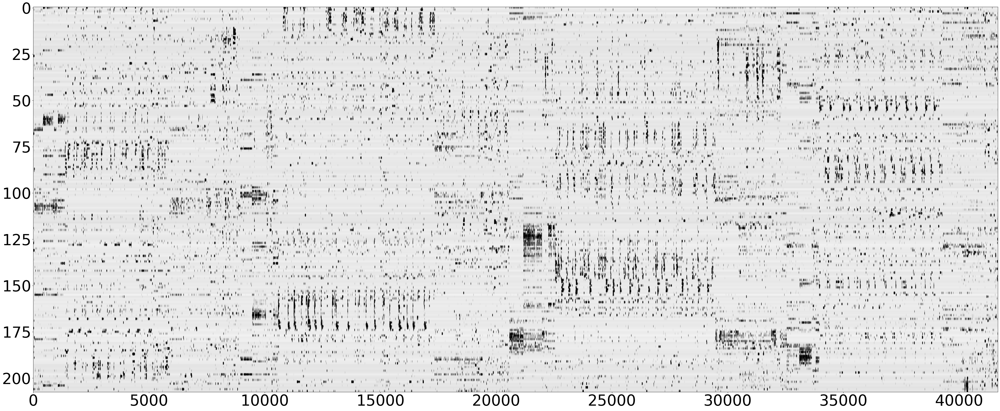

In [47]:

# the manifold embedding is in model.embedding
fs=20
# sort by embedding and smooth over neurons
#Sfilt = running_average(sp[isort, :], 3)
Sfilt = stats.zscore(Sfilt, axis=1)
xtick_time=np.linspace(0,np.shape(Sfilt)[1],20)
xtick_time_label=(xtick_time/fs)
#xtick_time_label=("["+', '.join(['%.0f']*len(xtick_time_label))+"]") % tuple(xtick_time_label)
figs=plt.figure(figsize=(50,40),dpi=80)

with plt.rc_context({'font.size': 51}):
       ax0=figs.add_axes([0.01,.01,0.9,.6])

       ax0.imshow(Sfilt, vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r',origin='lower')
       plt.xlabel('time s')
       ax0.set_ylabel('sorted neurons')
       plt.vlines(np.cumsum(trial_len)  ,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=.5)
       plt.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=2)
       ax0.set_xticks(session_len, names, rotation=90)  # Set text labels and properties.
       ax0.set_xticks(xtick_time, xtick_time_label.astype(int), minor=True)  # Set text labels and properties.
       ax0.set_xlim([0,len(locations[1,:])])
       ax1=figs.add_axes([0.01,.91,0.9,.09])
       ax1.plot((locations[0,:]),'g')
       ax1.plot((locations[1,:]),'k')
       ax1.plot(speed,'r')
       ax1.set_xlim([0,len(locations[1,:])])
       ax1.set_xticks([])
       ax1.set_title(name)
       for ix,seq in enumerate(seqs):
          a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          ax0.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
       
       #ax0.imshow(Sfilt2, vmin = 0, vmax=N+1, aspect='auto', origin='lower',cmap=newcmp,interpolation=None)
       
       
       ax2=figs.add_axes([0.01,.62,0.9,.29])
       for ix,seq in enumerate(seqs):
          a=np.arange(len(seq))/len(seq)+id_peaks[ix]
          ax2.scatter(a,seq,marker='|',color=colorlist[id_clusters[ix]])
       ax2.set_xticks([])
       #ax2.set_yticks([])
       ax2.set_xlim([0,len(locations[1,:])])
       ax2.plot(poprate/np.max(poprate)*sp.shape[0],alpha=.2)


       #plt.title(name)
       #plt.savefig(savefolder+name+'.pdf',bbox_inches='tight')
       #plt.savefig(savefolder+name+'.png',bbox_inches='tight')
       plt.show(block=0)

C:\Users\hamed\AppData\Local\Temp\ipykernel_6544\1347103153.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  plt.xticks(xtick_time, xtick_time, minor=True)  # Set text labels and properties.


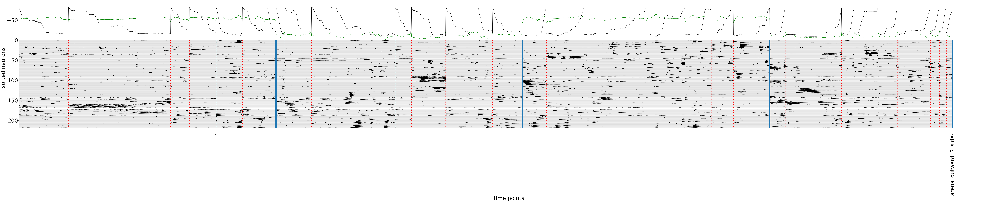

In [70]:

# separate plots
# the manifold embedding is in model.embedding
isort = np.argsort(model.embedding[:,0])
fs=20
# sort by embedding and smooth over neurons
#Sfilt = running_average(sp[isort, :], 3)
Sfilt = stats.zscore(Sfilt, axis=1)
xtick_time=np.linspace(0,np.shape(Sfilt)[1],20)
xtick_time_label=xtick_time/fs

with plt.rc_context({'font.size': 45}):
       ax0=figs.add_axes([0.1,.85,0.5,.05])
       plt.figure(figsize=(146,20))
       plt.imshow(Sfilt, vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r')
       plt.xlabel('time points')
       plt.ylabel('sorted neurons')
       plt.vlines(np.cumsum(trial_len)  ,0,np.shape(Sfilt)[0],'r',linestyles ="dotted",linewidth=5)
       plt.vlines(session_len,0,np.shape(Sfilt)[0],linewidth=10)
       plt.xticks(session_len, names, rotation=90)  # Set text labels and properties.
       plt.xticks(xtick_time, xtick_time, minor=True)  # Set text labels and properties.

       plt.plot(zscore(locations[0,:])*np.shape(Sfilt)[0]/10-35,'g')
       plt.plot(zscore(locations[1,:])*np.shape(Sfilt)[0]/10-35,'k')



       plt.savefig(savefolder+'arena rastermap .pdf',bbox_inches='tight')
       plt.savefig(savefolder+'arena rastermap.png',bbox_inches='tight')
       plt.show(block=0)

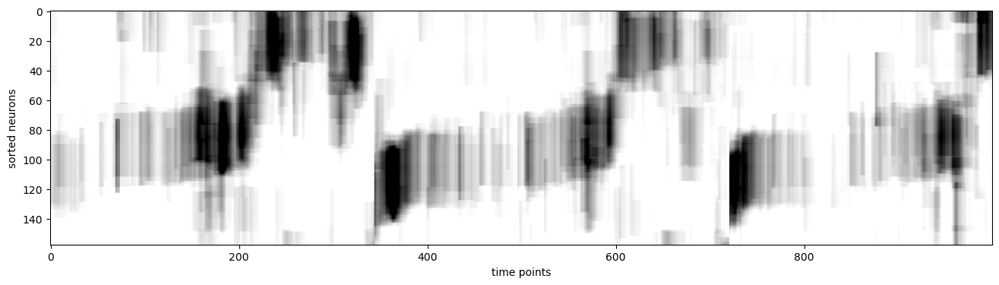

In [182]:
plt.figure(figsize=(16,4))
plt.imshow(Sfilt[:,9000:10000], vmin = -0.5, vmax=3, aspect='auto', cmap='gray_r')
plt.xlabel('time points')
plt.ylabel('sorted neurons')
plt.show()

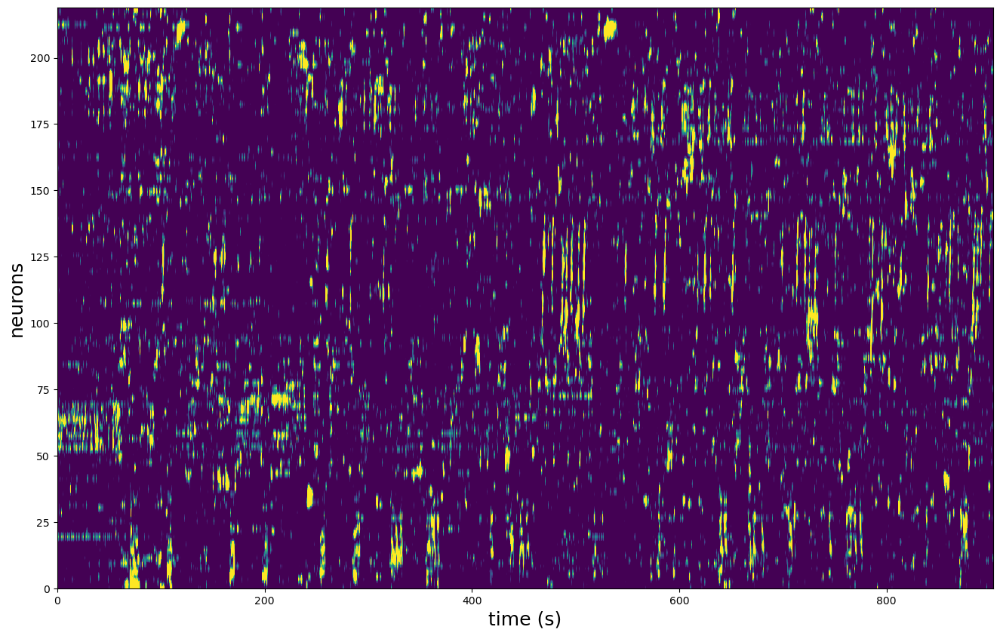

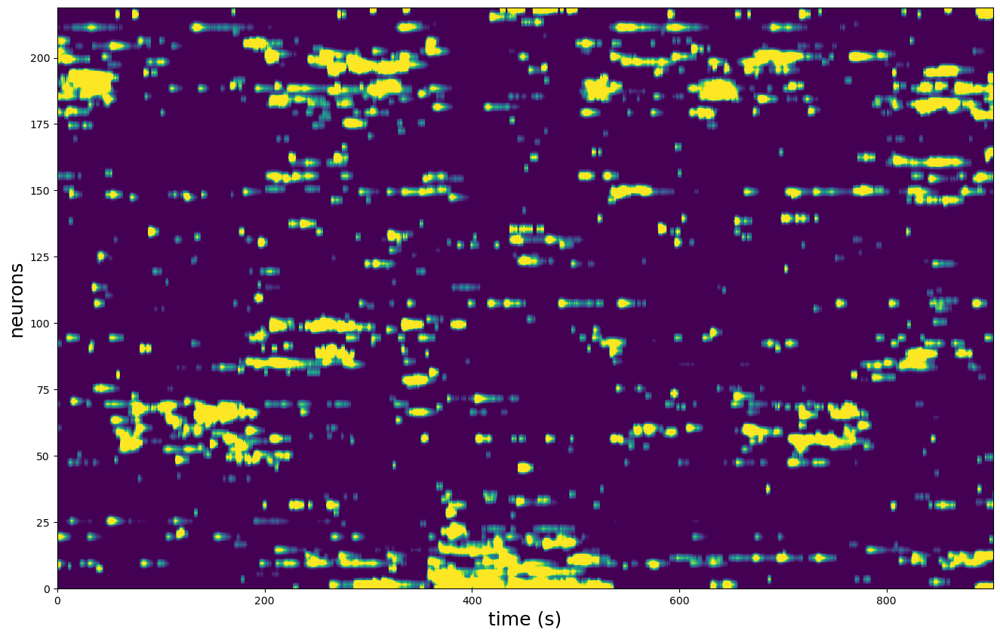

In [118]:
### sort neurons and smooth across neurons and zscore in time
isort = np.argsort(model.embedding[:,0])
Sm = gaussian_filter1d(sp[isort,:].T, np.minimum(3,int(sp.shape[0]*0.005)), axis=1)
Sm = Sm.T

# (optional) smooth in time
#Sm = gaussian_filter1d(Sm, 1, axis=1)
### view neuron sorting
fs = 20 # sampling rate of data in Hz
#splot = Sm[::-1,1500:1800]
splot=Sm
plt.figure(figsize=(16,10))
ax=plt.imshow(splot, vmin=0,vmax=1.5,aspect='auto',extent=[0,splot.shape[1]/fs, 0,splot.shape[0]])
plt.xlabel('time (s)', fontsize=18)
plt.ylabel('neurons', fontsize=18)
plt.show()

plt.figure(figsize=(16,10))
ax=plt.imshow(splot[:,1000:2000], vmin=0,vmax=1.5,aspect='auto',extent=[0,splot.shape[1]/fs, 0,splot.shape[0]])
plt.xlabel('time (s)', fontsize=18)
plt.ylabel('neurons', fontsize=18)
plt.show()